# Visualization of flatmaps
visual vs cortical space connective fields and psc vs z-scored + pRF data

In [105]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [106]:
import cortex
from prfpy.utils import Subsurface
from scipy.io import loadmat
from scipy.ndimage import median_filter, gaussian_filter, binary_propagation
import matplotlib.animation as animation
from prfpy.stimulus import PRFStimulus2D
from prfpy.model import Iso2DGaussianModel, CSS_Iso2DGaussianModel
from prfpy.fit import Iso2DGaussianFitter, CSS_Iso2DGaussianFitter
import pandas as pd
from scipy.spatial.distance import squareform
import nibabel as nib
import numpy as np
from prfpy.stimulus import CFStimulus
from prfpy.model import CFGaussianModel
from prfpy.fit import CFFitter
import matplotlib.pyplot as plt


In [97]:
roi_verts = cortex.get_roi_verts('hcp_999999', 'V1',mask=True)

maskL=roi_verts['V1'][:59292]
maskR=roi_verts['V1'][59292:]

V1_mask = np.concatenate([maskL,maskR])

In [132]:
def angle(x0, y0):
    return np.angle(x0 + y0 * 1j)

def ecc(x0, y0):
    return np.abs(x0 + y0 * 1j)

def splitList(array):
    n = len(array)
    half = int(n/2) # py3
    return array[:half], array[n-half:]

import h5py
idxs = h5py.File('/tank/shared/timeless/atlases/cifti_indices.hdf5', "r")
lidxs = np.array(idxs['Left_indices'])
ridxs = np.array(idxs['Right_indices'])

def get_cortex(dat):
    l, r, = dat[lidxs], dat[ridxs]

    # Replace the minus 1
    l[lidxs == -1] = np.zeros_like(l[lidxs == -1])
    r[ridxs == -1] = np.zeros_like(r[ridxs == -1])

    # Last dimension time.
    # l, r = l.T, r.T

    data = np.concatenate([l, r])
    return data

def alpha_plot(dat,dat2,vmax,subject='fsaverage',vmin=0,rois=False,colorbar=False,cmap='plasma_alpha',ax=None):
    light=cortex.Vertex2D(dat,dat2,subject=subject, vmin=vmin, vmax=vmax,vmin2=0,vmax2=np.nanmax(dat2),cmap=cmap)
    mfig=cortex.quickshow(light,with_curvature=True,with_rois=rois,with_colorbar=colorbar,fig=ax)

In [130]:
from nilearn.surface import load_surf_data
import os

roi_index_dict = {
    # somatosensory:
    'CS1_4': 8, 'CS2_3a': 53, 'CS3_3b': 9, 'CS4_1': 51, 'CS5_2': 52,
    # auditory:
    'A1': 24, 'PBelt': 124, 'MBelt': 173, 'LBelt': 174, '52': 103, 'RI': 104,
    # low-level visual:
    'V1': 1, 'V2': 4, 'V3': 5,
    # mid-level and high-level visual:
    'V3A': 13, 'V3B': 19, 'IPS1': 17, 'LIPv': 48, 'LIPd': 95, 
    'VIP': 49, 'FEF': 10, 'MST': 2, 'MT': 23, 'LO1': 20, 'LO2': 21, 'LO3': 159
    }

atlas_data = np.concatenate([load_surf_data(
        os.path.join('/tank/klundert/content/data/atlas', f'Q1-Q6_RelatedParcellation210.CorticalAreas_dil_Colors.59k_fs_LR.dlabel.{hemi}.gii'))
         for hemi in ['L', 'R']])
atlas_data_both_hemis = np.mod(atlas_data, 180)


ind = np.array(list(roi_index_dict.values()))[12:]
boolmask = atlas_data_both_hemis == roi_index_dict['V1']
for i, ROIs in enumerate(ind):
  boolmask = np.array(atlas_data_both_hemis == ind[i]) + boolmask
  print(ROIs)
    
    


4
5
13
19
17
48
95
49
10
2
23
20
21
159


In [99]:
[~V1_mask] = np.nan


In [109]:
MTmask = atlas_data_both_hemis == roi_index_dict['MT']
MTmask.sum()
MSTmask = atlas_data_both_hemis == roi_index_dict['MST']
combmask = MTmask + MSTmask

fefmask = atlas_data_both_hemis == roi_index_dict['FEF']

## SUB 2: load data and plot flatmaps

In [110]:
CF_cort = np.zeros((118584, 5))
CF_cort[:] = np.nan

CF_cort_zsc = np.zeros((118584, 5))
CF_cort_zsc[:] = np.nan

CF_vis = np.zeros((118584, 5))
CF_vis[:] = np.nan

CF_vis_zsc = np.zeros((118584, 5))
CF_vis_zsc[:] = np.nan

CF_norm1 = np.zeros((118584, 9))
CF_norm1[:] = np.nan

CF_gauss1 = np.zeros((118584, 5))
CF_gauss1[:] = np.nan


CF_norm2 = np.zeros((118584, 9))
CF_norm2[:] = np.nan

CF_gauss2 = np.zeros((118584, 5))
CF_gauss2[:] = np.nan


CF_norm1_vis = np.zeros((118584, 9))
CF_norm1_vis[:] = np.nan

CF_gauss1_vis = np.zeros((118584, 5))
CF_gauss1_vis[:] = np.nan

CF_gauss1_logvis = np.zeros((118584, 5))
CF_gauss1_logvis[:] = np.nan

CF_norm1_logvis = np.zeros((118584, 9))
CF_norm1_logvis[:] = np.nan

In [134]:
fold = 1
sub = 2

gauss_prf = get_cortex(np.load(f'/scratch/2021/nprf_ss/derivatives/prf-fits/sub-0{sub}/gaussian-prf/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gaussPRF_params_cv_fold{fold}.npy'))
norm_prf = get_cortex(np.load(f'/scratch/2021/nprf_ss/derivatives/prf-fits/sub-0{sub}/dn-prf/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_normPRF_params_cv_fold{fold}.npy'))

CF_cort[boolmask] = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/cortical_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_cortical_space_fold{fold}.npy')
CF_vis[boolmask] = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/visual_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_visual_space_fold{fold}.npy')

CF_cort_zsc[boolmask] = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/cortical_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_cortical_space_fold{fold}_zsc.npy')
CF_vis_zsc[boolmask] = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/visual_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_visual_space_fold{fold}_zsc.npy')

CF_norm1[boolmask] = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/cortical_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_norm_CF_params_cortical_space_fold{fold}_zsc.npy')
CF_gauss1[boolmask] = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/cortical_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_cortical_space_fold{fold}_zsc.npy')


CF_norm1_vis[boolmask] = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/visual_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_norm_CF_params_visual_space_fold{fold}_zsc.npy')
CF_gauss1_vis[boolmask] = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/visual_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_visual_space_fold{fold}_zsc.npy')
CF_gauss1_logvis[boolmask] = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/visual_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_LOGvisual_space_fold{fold}_zsc.npy')
CF_norm1_logvis[boolmask] = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/visual_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_norm_CF_params_LOGvisual_space_fold{fold}_zsc.npy')

# CF_norm1[boolmask] = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/dn-cf/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_norm_CF_params_full_fold{fold}.npy')[boolmask]
# CF_norm2[boolmask] = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/dn-cf/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_norm_CF_params_full_fold2.npy')[boolmask]

# CF_gauss1[boolmask] = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/gauss-cf/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_full_fold{sub}.npy')[boolmask]
# CF_gauss2[boolmask] = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/gauss-cf/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_full_fold2.npy')[boolmask]


# CF_norm1[:,-1][CF_gauss1[:,-1]<0.05] = 0
# CF_gauss1[:,-1][CF_gauss1[:,-1]<0.05] = 0

# CF_norm2[:,-1][CF_gauss2[:,-1]<0.05] = 0
# CF_gauss2[:,-1][CF_gauss2[:,-1]<0.05] = 0
                             
# gauss_avg = (CF_gauss1+CF_gauss2)/2
# norm_avg = (CF_norm1+CF_norm2)/2

# gauss_avg[:,-1][gauss_avg[:,-1]<0.05] = 0
# norm_avg[:,-1][gauss_avg[:,-1]<0.05] = 0



gfn_ecc = ecc(gauss_prf[:,0], gauss_prf[:,1])
gfn_angle = angle(gauss_prf[:,1], gauss_prf[:,0])
# CF_norm1[:,-1]-CF_gauss[:,-1]
d = {'ecc': gfn_ecc, 'angle': gfn_angle}
ret_frame = pd.DataFrame(data=d)
spliced_lookup_vis=ret_frame.iloc[CF_gauss1_vis[boolmask][:,3].astype(int),:]
spliced_lookup_cort=ret_frame.iloc[CF_gauss1[boolmask][:,3].astype(int),:]

In [135]:
CF_cort[V1_mask] = np.nan
CF_vis[V1_mask] = np.nan
CF_cort_zsc[V1_mask] = np.nan
CF_vis_zsc[V1_mask] = np.nan

CF_norm1[V1_mask] = np.nan
CF_gauss1[V1_mask] = np.nan


CF_norm1_vis[V1_mask] = np.nan
CF_gauss1_vis[V1_mask] = np.nan
CF_gauss1_logvis[V1_mask] = np.nan
CF_norm1_logvis[V1_mask] = np.nan

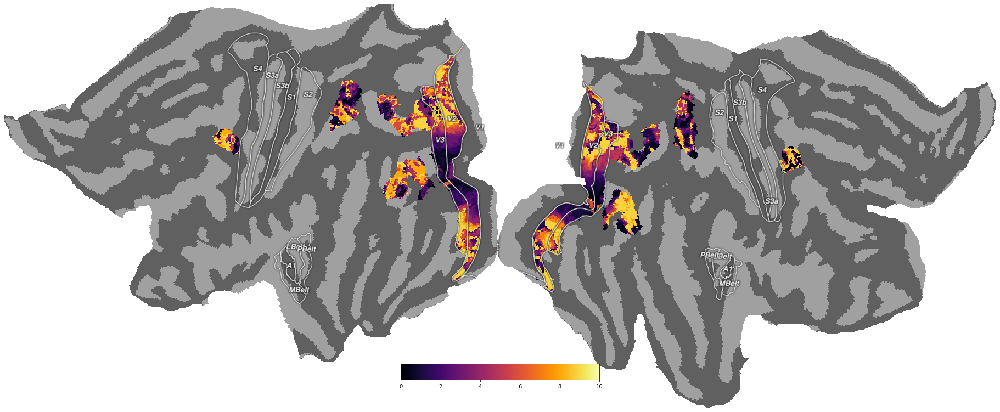

In [136]:
eccn = np.zeros(118584,)
eccn[:] = np.nan
eccn[boolmask] = spliced_lookup_cort['ecc']
eccn[V1_mask] = np.nan
f = cortex.quickshow(cortex.Vertex(eccn, subject='hcp_999999', cmap='inferno', vmin=0, vmax=10), with_curvature=True);

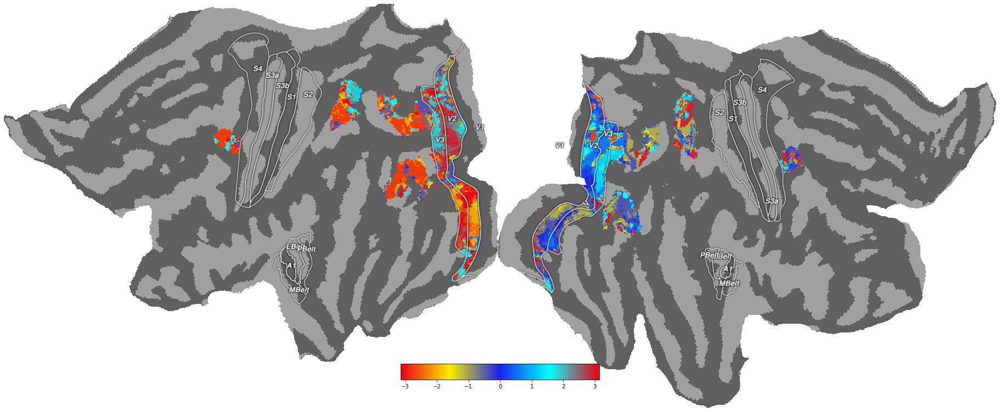

In [137]:
ecc = np.zeros(118584,)
ecc[:] = np.nan
ecc[boolmask] = spliced_lookup_cort['angle']
ecc[V1_mask] = np.nan
f = cortex.quickshow(cortex.Vertex(ecc, subject='hcp_999999', cmap='Retinotopy_RYBCR', vmin=-np.pi, vmax=np.pi), with_curvature=True);

Text(0.5, 0.98, 'R2 Cortical space DN')

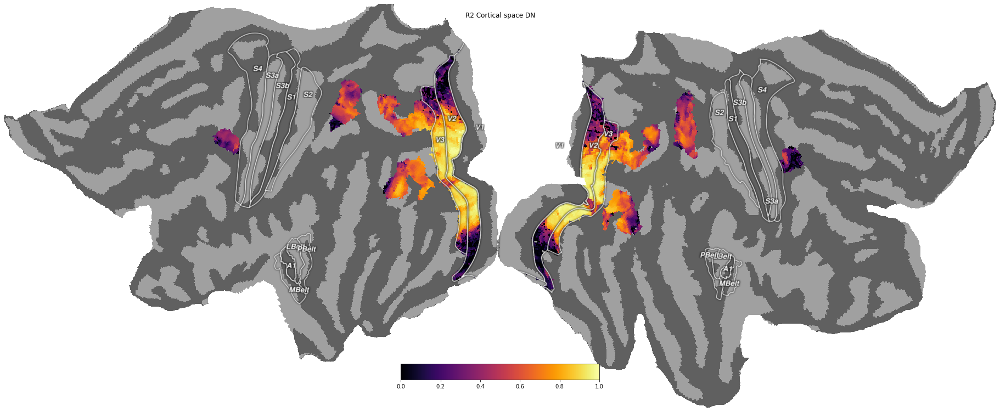

In [139]:
f = cortex.quickshow(cortex.Vertex(CF_norm1[:,-1], subject='hcp_999999', cmap='inferno', vmin=0, vmax=1), with_curvature=True);
f.suptitle(f'R2 Cortical space DN') 

Text(0.5, 0.98, 'R2 Cortical space DN - gauss sub 2')

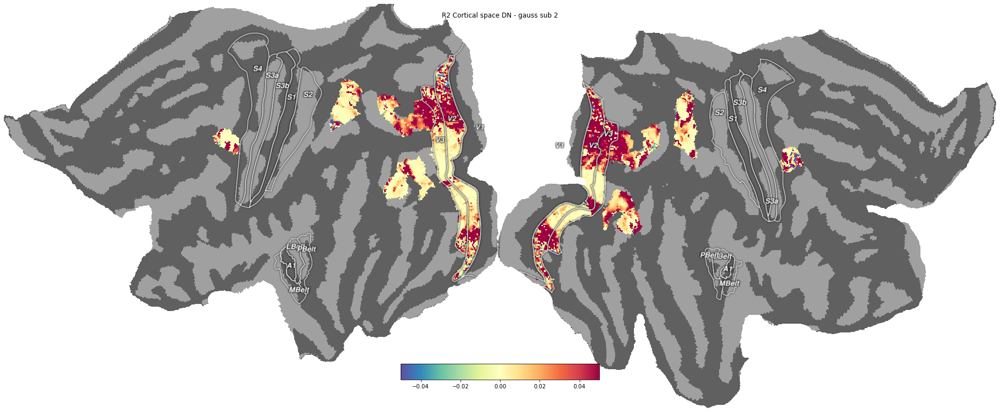

In [116]:
f = cortex.quickshow(cortex.Vertex(CF_norm1[:,-1]-CF_gauss1[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.05, vmax=0.05), with_curvature=True);
f.suptitle(f'R2 Cortical space DN - gauss sub {sub}') 

In [25]:
((CF_norm1[:,-1]-CF_gauss1[:,-1]) > 0.4).sum()

/tank/klundert/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in greater
  """Entry point for launching an IPython kernel.


421

In [1]:
f = cortex.quickshow(cortex.Vertex(CF_norm1_logvis[:,-1]-CF_gauss1_logvis[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.05, vmax=0.05), with_curvature=True);
f.suptitle(f'CV R2 Visual CF norm - gauss sub {sub}')

NameError: name 'cortex' is not defined

Text(0.5, 0.98, 'R2 gauss CF cortical space - logvisual sub 2')

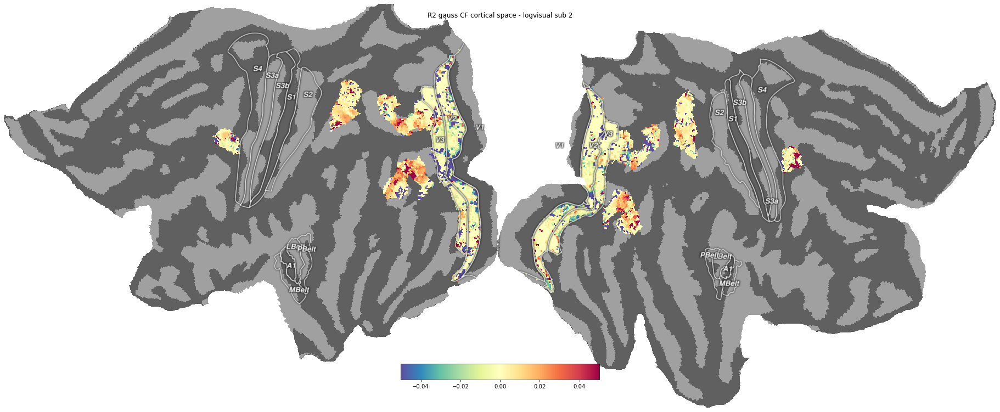

In [123]:
f = cortex.quickshow(cortex.Vertex(CF_gauss1_vis[:,-1]-CF_gauss1_logvis[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.05, vmax=0.05), with_curvature=True);
f.suptitle(f'R2 gauss CF cortical space - logvisual sub {sub}')

Text(0.5, 0.98, 'CV R2 norm CF cortical space - log visual sub 2')

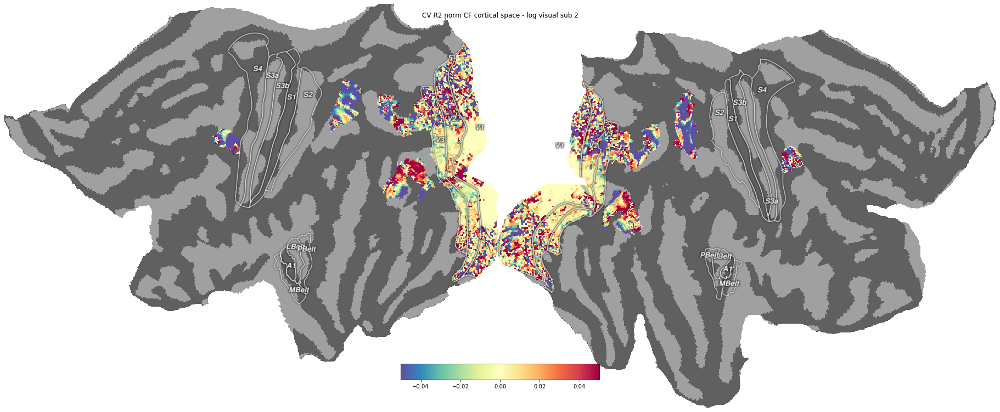

In [772]:
f = cortex.quickshow(cortex.Vertex(CF_norm1[:,-1]-CF_norm1_logvis[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.05, vmax=0.05), with_curvature=True);
f.suptitle(f'CV R2 norm CF cortical space - log visual sub {sub}')

Text(0.5, 0.98, 'CV R2 DN CF visual sub 2')

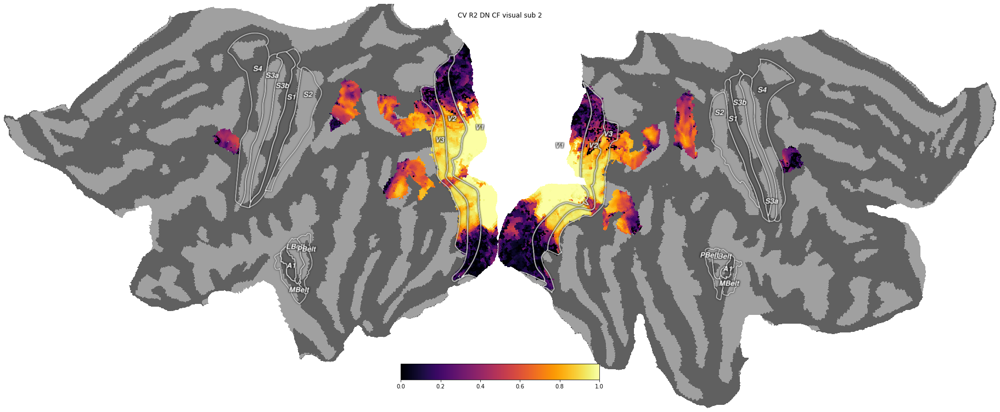

In [736]:
f = cortex.quickshow(cortex.Vertex(CF_norm1_logvis[:,-1], subject='hcp_999999', cmap='inferno', vmin=0, vmax=1), with_curvature=True);
f.suptitle(f'CV R2 DN CF visual sub {sub}')

Text(0.5, 0.98, 'CV R2 sigma visual space sub 1')

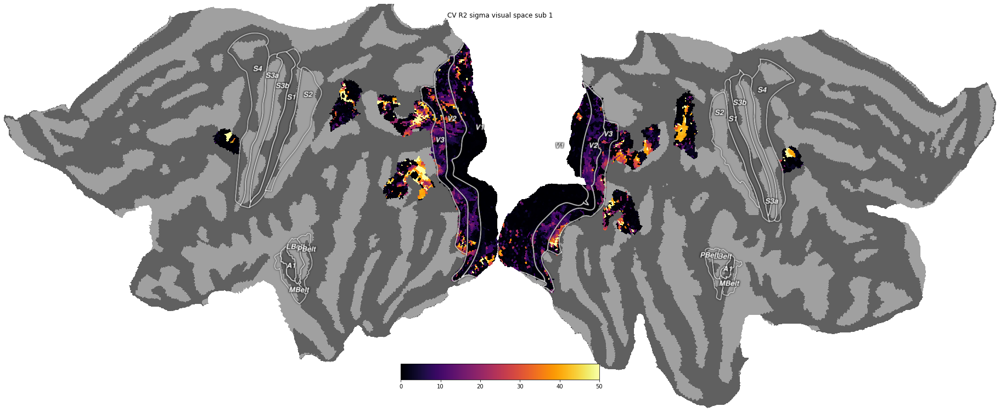

In [747]:
f = cortex.quickshow(cortex.Vertex(CF_norm1_logvis[:,0], subject='hcp_999999', cmap='inferno', vmin=0, vmax=50), with_curvature=True);
f.suptitle(f'CV R2 sigma visual space sub {sub}')

/tank/klundert/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in greater
  """Entry point for launching an IPython kernel.


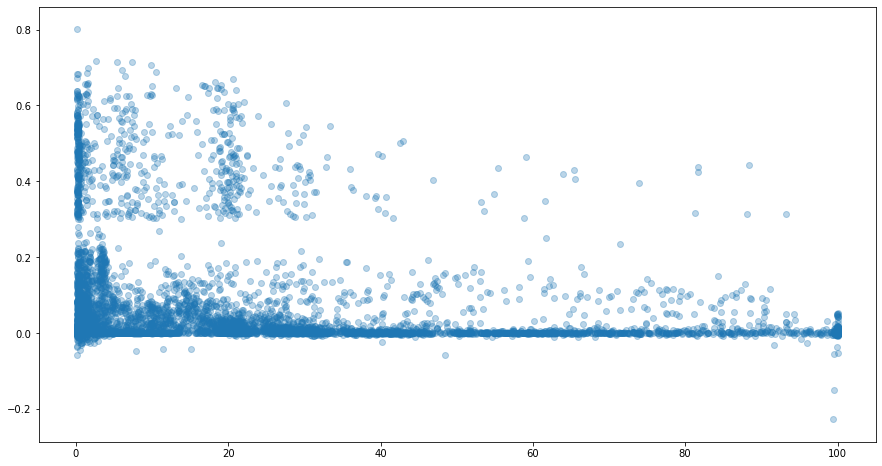

In [783]:
rsqmask = CF_gauss1_logvis[:,-1] > 0.3
fig, ax = plt.subplots()
ax.scatter(CF_gauss1_logvis[:,0][rsqmask], CF_gauss1_logvis[:,-1][rsqmask]-CF_gauss1[:,-1][rsqmask], alpha=0.3)

/tank/klundert/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in greater
  """Entry point for launching an IPython kernel.


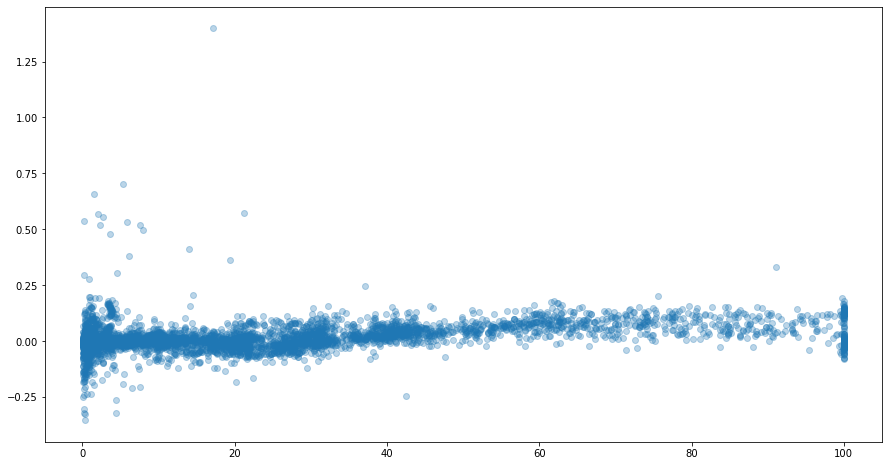

In [784]:
rsqmask = CF_norm1_logvis[:,-1] > 0.5
fig, ax = plt.subplots()
ax.scatter(CF_norm1_logvis[:,0][rsqmask], CF_norm1_logvis[:,-1][rsqmask]-CF_norm1[:,-1][rsqmask], alpha=0.3)

In [725]:
# f = cortex.quickshow(cortex.Vertex(CF_norm1[:,-1], subject='hcp_999999', cmap='inferno', vmin=0, vmax=1), with_curvature=True);
# f.suptitle(f'CV R2 Cortical CF norm - gauss sub {sub}')

In [726]:
# diff = CF_gauss1[:,-1]
# for keys in list(roi_index_dict.keys())[12:]:
#     plt.figure(figsize=[15,8])
#     roi_mask = atlas_data_both_hemis == roi_index_dict[keys]
    
#     plt.hist(diff[roi_mask], bins=50, range=[-1,1])
# #     plt.hist(CF_vis_zsc[:,-1][roi_mask], alpha=0.5, label='visual space, median = ' +str(np.nanmedian(CF_vis_zsc[:,-1][roi_mask])), bins=50, range=[-1,1])
    
# #     plt.legend(loc='upper left')
#     plt.title(f'subject {sub}: ' + str(keys) + ' DN - gauss CF Rsq psc')

In [727]:
# rdiff = CF_norm1[:,-1]-CF_gauss1[:,-1]
# # rduff = norm_avg[:,-1]-gauss_avg[:,-1]
# # rdiff = CF_vis_zsc[:,-1] - CF_cort_zsc[:,-1]
# plt.figure(figsize=(16, 9))
# for l, ROI in enumerate(list(roi_index_dict)[12:]):

#     boolmask2 = atlas_data_both_hemis == roi_index_dict[ROI]
    
#     plt.bar(l, np.nanmedian(rdiff[boolmask2]))
# #     plt.hist(diff[boolmask2], bins=100, range=[-1,60])
#     plt.title(f'Sub {sub} Median Rsq difference per ROI (DN - gauss) in cortical space')
#     plt.show
    
# plt.xticks(np.arange(len(list(roi_index_dict)[12:])), list(roi_index_dict)[12:])

Text(0.5, 0, 'ROI')

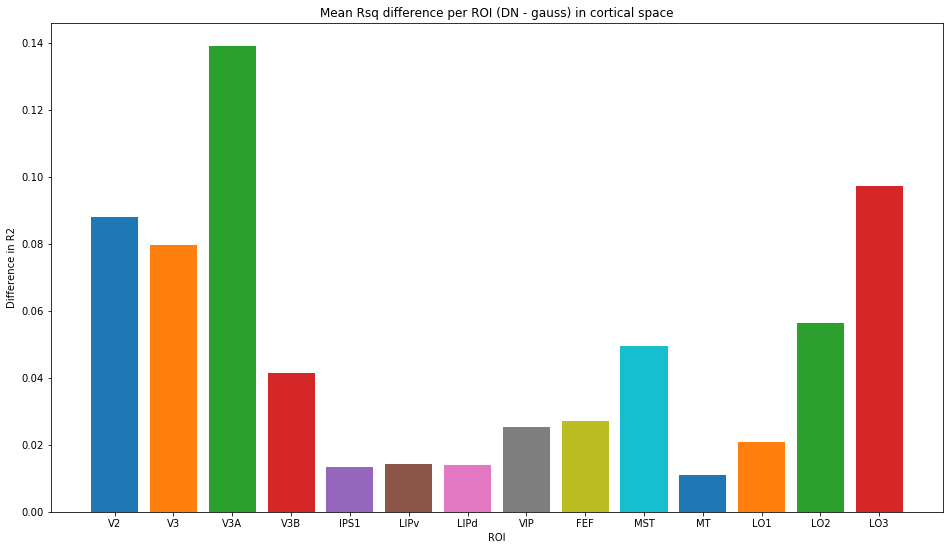

In [197]:
rdiff = CF_norm1[:,-1]-CF_gauss1[:,-1]
# rduff = norm_avg[:,-1]-gauss_avg[:,-1]
# rdiff = CF_vis_zsc[:,-1] - CF_cort_zsc[:,-1]
plt.figure(figsize=(16, 9))
for l, ROI in enumerate(list(roi_index_dict)[12:]):

    boolmask2 = atlas_data_both_hemis == roi_index_dict[ROI]
    
    plt.bar(l, np.nanmean(rdiff[boolmask2]))
#     plt.hist(diff[boolmask2], bins=100, range=[-1,60])
    plt.title(f'Mean Rsq difference per ROI (DN - gauss) in cortical space')
    plt.show
    
plt.xticks(np.arange(len(list(roi_index_dict)[12:])), list(roi_index_dict)[12:])
plt.ylabel('Difference in R2')
plt.xlabel('ROI')

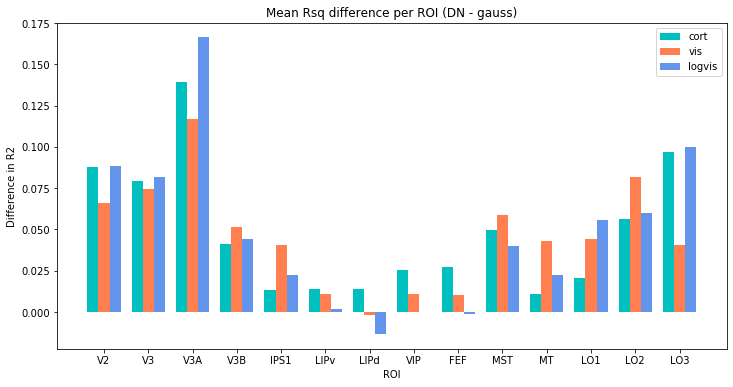

In [194]:
rdiff = CF_norm1[:,-1]-CF_gauss1[:,-1]
rdiff2 = CF_norm1_vis[:,-1]-CF_gauss1_vis[:,-1]
rdiff3 = CF_norm1_logvis[:,-1]-CF_gauss1_logvis[:,-1]
# rduff = norm_avg[:,-1]-gauss_avg[:,-1]
# rdiff = CF_vis_zsc[:,-1] - CF_cort_zsc[:,-1]
plt.figure(figsize=(12, 6))
for l, ROI in enumerate(list(roi_index_dict)[12:]):

    boolmask2 = atlas_data_both_hemis == roi_index_dict[ROI]
    if l ==0:
        plt.bar(l, np.nanmean(rdiff[boolmask2]), width = 0.25, label='cort', color='teal')
        plt.bar(l+0.25, np.nanmean(rdiff2[boolmask2]), width = 0.25, label='vis', color='coral')
        plt.bar(l+0.5, np.nanmean(rdiff3[boolmask2]), width = 0.25, label='logvis', color='cornflowerblue')
    else:
        plt.bar(l, np.nanmean(rdiff[boolmask2]), width = 0.25, color='teal')
        plt.bar(l+0.25, np.nanmean(rdiff2[boolmask2]), width = 0.25, color='coral')
        plt.bar(l+0.5, np.nanmean(rdiff3[boolmask2]), width = 0.25, color='cornflowerblue')


#     plt.hist(diff[boolmask2], bins=100, range=[-1,60])
    plt.title(f'Mean Rsq difference per ROI (DN - gauss)')
    plt.show
    
plt.xticks(np.arange(len(list(roi_index_dict)[12:]))+0.25, list(roi_index_dict)[12:])
plt.ylabel('Difference in R2')
plt.xlabel('ROI')
plt.legend()

([<matplotlib.axis.XTick at 0x1554639073d0>,
 <a list of 14 Text xticklabel objects>)

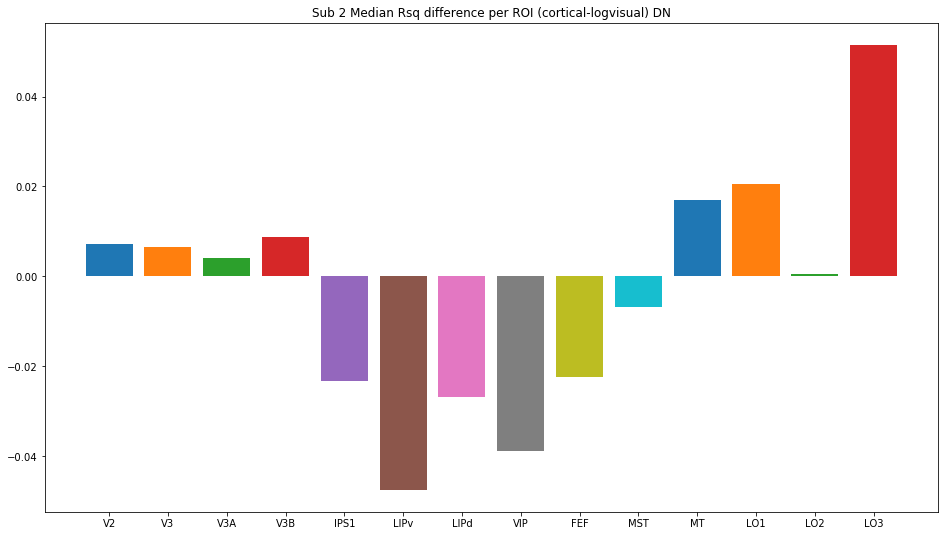

In [156]:
rdiff = CF_norm1[:,-1]-CF_norm1_logvis[:,-1]
# rduff = norm_avg[:,-1]-gauss_avg[:,-1]
# rdiff = CF_vis_zsc[:,-1] - CF_cort_zsc[:,-1]
plt.figure(figsize=(16, 9))
for l, ROI in enumerate(list(roi_index_dict)[12:]):

    boolmask2 = atlas_data_both_hemis == roi_index_dict[ROI]
    
    plt.bar(l, np.nanmean(rdiff[boolmask2]))
#     plt.hist(diff[boolmask2], bins=100, range=[-1,60])
    plt.title(f'Sub {sub} Median Rsq difference per ROI (cortical-logvisual) DN')
    plt.show
    
plt.xticks(np.arange(len(list(roi_index_dict)[12:])), list(roi_index_dict)[12:])

In [730]:
# rdiff = CF_norm1[:,-1]-CF_norm1_logvis[:,-1]
# # rduff = norm_avg[:,-1]-gauss_avg[:,-1]
# # rdiff = CF_vis_zsc[:,-1] - CF_cort_zsc[:,-1]
# plt.figure(figsize=(16, 9))
# for l, ROI in enumerate(list(roi_index_dict)[12:]):

#     boolmask2 = atlas_data_both_hemis == roi_index_dict[ROI]
    
#     plt.bar(l, np.nanmedian(rdiff[boolmask2]))
# #     plt.hist(diff[boolmask2], bins=100, range=[-1,60])
#     plt.title(f'Sub {sub} Median Rsq difference per ROI (DN - gauss)')
#     plt.show
    
# plt.xticks(np.arange(len(list(roi_index_dict)[12:])), list(roi_index_dict)[12:])

In [731]:
# for l, ROI in enumerate(list(roi_index_dict)[12:]):
#     if l == 0:
#         boolmask2 = atlas_data_both_hemis == roi_index_dict[ROI]
#         df = pd.DataFrame(CF_gauss1[:,-1][boolmask2]-CF_gauss1_logvis[:,-1][boolmask2])
#         df['ROI'] = f'{ROI}'
#         df['model'] = 'gauss'
        
#         df2 = pd.DataFrame(CF_norm1[:,-1][boolmask2]-CF_norm1_logvis[:,-1][boolmask2])
#         df2['ROI'] = f'{ROI}'
#         df2['model'] = 'DN'
#         df = df.append(df2, ignore_index=True)
#     boolmask2 = atlas_data_both_hemis == roi_index_dict[ROI]
#     df2 = pd.DataFrame(CF_gauss1[:,-1][boolmask2]-CF_gauss1_logvis[:,-1][boolmask2])
#     df2['ROI'] = f'{ROI}'
#     df2['model'] = 'gauss'
#     df = df.append(df2, ignore_index=True)
    
#     df2 = pd.DataFrame(CF_norm1[:,-1][boolmask2]-CF_norm1_logvis[:,-1][boolmask2])
#     df2['ROI'] = f'{ROI}'
#     df2['model'] = 'DN'
#     df = df.append(df2, ignore_index=True)
    
# df.columns =['Rsq', 'ROI', 'model']   
# rcParams['figure.figsize'] = 15,8

# # Draw a nested violinplot and split the violins for easier comparison
# sns.violinplot(data=df, x="ROI", y='Rsq', hue="model",
#                split=True, inner="quart", linewidth=1).set(title=f'Sub {sub} cortical-visual space rsq for gauss and DN')
# sns.despine(left=True)

# plt.ylim(-0.5, 0.5)

In [732]:
# for l, ROI in enumerate(list(roi_index_dict)[12:]):
#     if l == 0:
#         boolmask2 = atlas_data_both_hemis == roi_index_dict[ROI]
#         df = pd.DataFrame(CF_gauss1_vis[:,-1][boolmask2])
#         df['ROI'] = f'{ROI}'
#         df['model'] = 'gauss'
        
#         df2 = pd.DataFrame(CF_norm1_vis[:,-1][boolmask2])
#         df2['ROI'] = f'{ROI}'
#         df2['model'] = 'DN'
#         df = df.append(df2, ignore_index=True)
#     boolmask2 = atlas_data_both_hemis == roi_index_dict[ROI]
#     df2 = pd.DataFrame(CF_gauss1_vis[:,-1][boolmask2])
#     df2['ROI'] = f'{ROI}'
#     df2['model'] = 'gauss'
#     df = df.append(df2, ignore_index=True)
    
#     df2 = pd.DataFrame(CF_norm1_vis[:,-1][boolmask2])
#     df2['ROI'] = f'{ROI}'
#     df2['model'] = 'DN'
#     df = df.append(df2, ignore_index=True)
    
# df.columns =['Rsq', 'ROI', 'model']   
# rcParams['figure.figsize'] = 15,8

# # Draw a nested violinplot and split the violins for easier comparison
# sns.violinplot(data=df, x="ROI", y='Rsq', hue="model", cut=0,
#                split=True, inner="quart", linewidth=1).set(title=f'Sub {sub} gaussian vs. DN, visual space')
# sns.despine(left=True)

# plt.ylim(-1.1, 1.1)

In [204]:
import seaborn as sns
from matplotlib import rcParams


(-1.1, 1.1)

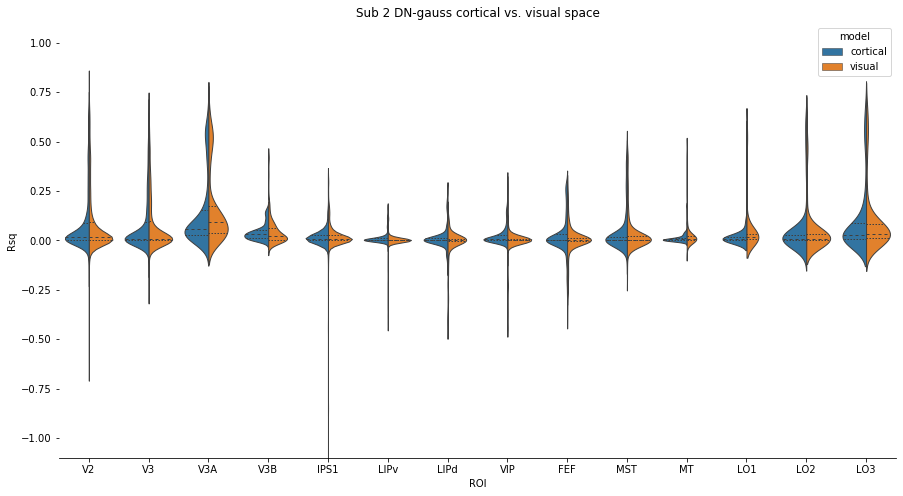

In [207]:
for l, ROI in enumerate(list(roi_index_dict)[12:]):
    if l == 0:
        boolmask2 = atlas_data_both_hemis == roi_index_dict[ROI]
        df = pd.DataFrame(CF_norm1[:,-1][boolmask2]-CF_gauss1[:,-1][boolmask2])
        df['ROI'] = f'{ROI}'
        df['model'] = 'cortical'
        
        df2 = pd.DataFrame(CF_norm1_logvis[:,-1][boolmask2]-CF_gauss1_logvis[:,-1][boolmask2])
        df2['ROI'] = f'{ROI}'
        df2['model'] = 'visual'
        df = df.append(df2, ignore_index=True)
    boolmask2 = atlas_data_both_hemis == roi_index_dict[ROI]
    df2 = pd.DataFrame(CF_norm1[:,-1][boolmask2]-CF_gauss1[:,-1][boolmask2])
    df2['ROI'] = f'{ROI}'
    df2['model'] = 'cortical'
    df = df.append(df2, ignore_index=True)
    
    df2 = pd.DataFrame(CF_norm1_logvis[:,-1][boolmask2]-CF_gauss1_logvis[:,-1][boolmask2])
    df2['ROI'] = f'{ROI}'
    df2['model'] = 'visual'
    df = df.append(df2, ignore_index=True)
    
df.columns =['Rsq', 'ROI', 'model']    
    
rcParams['figure.figsize'] = 15,8

# Draw a nested violinplot and split the violins for easier comparison
sns.violinplot(data=df, x="ROI", y='Rsq', hue="model",
               split=True, inner="quart", linewidth=1).set(title=f'Sub {sub} DN-gauss cortical vs. visual space')
sns.despine(left=True)

plt.ylim(-1.1, 1.1)

array([0.86571704,        nan,        nan, ..., 0.30071426, 0.30247492,
       0.30639215])

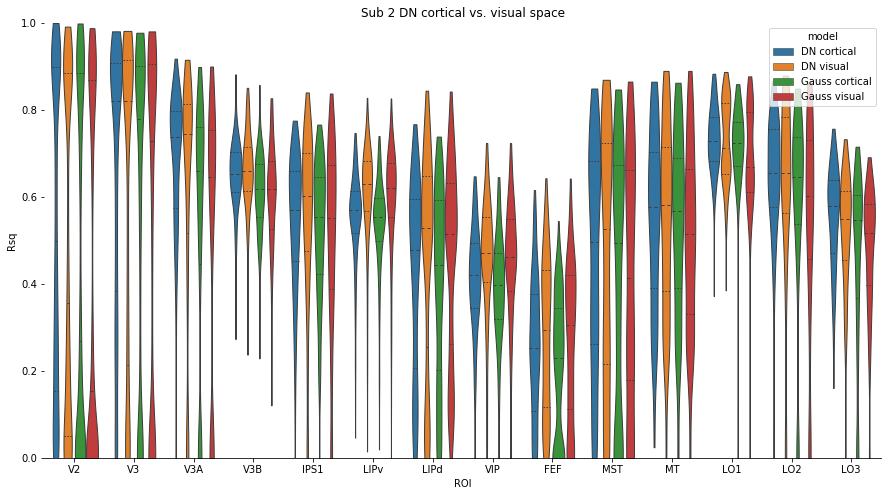

In [226]:
for l, ROI in enumerate(list(roi_index_dict)[12:]):
    if l == 0:
        boolmask2 = atlas_data_both_hemis == roi_index_dict[ROI]
        df = pd.DataFrame(CF_norm1[:,-1][boolmask2])
        df['ROI'] = f'{ROI}'
        df['model'] = 'DN cortical'
        
        df2 = pd.DataFrame(CF_norm1_vis[:,-1][boolmask2])
        df2['ROI'] = f'{ROI}'
        df2['model'] = 'DN visual'
        
        df3 = pd.DataFrame(CF_gauss1[:,-1][boolmask2])
        df3['ROI'] = f'{ROI}'
        df3['model'] = 'Gauss cortical'
        
        df4 = pd.DataFrame(CF_gauss1_vis[:,-1][boolmask2])
        df4['ROI'] = f'{ROI}'
        df4['model'] = 'Gauss visual'
        
        df = df.append(df2, ignore_index=True)
        df = df.append(df3, ignore_index=True)
        df = df.append(df4, ignore_index=True)
        
    boolmask2 = atlas_data_both_hemis == roi_index_dict[ROI]
    df2 = pd.DataFrame(CF_norm1[:,-1][boolmask2])
    df2['ROI'] = f'{ROI}'
    df2['model'] = 'DN cortical'
    df = df.append(df2, ignore_index=True)
    
    df2 = pd.DataFrame(CF_norm1_vis[:,-1][boolmask2])
    df2['ROI'] = f'{ROI}'
    df2['model'] = 'DN visual'
    df = df.append(df2, ignore_index=True)
    
    df2 = pd.DataFrame(CF_gauss1[:,-1][boolmask2])
    df2['ROI'] = f'{ROI}'
    df2['model'] = 'Gauss cortical'
    df = df.append(df2, ignore_index=True)
    
    df2 = pd.DataFrame(CF_gauss1_vis[:,-1][boolmask2])
    df2['ROI'] = f'{ROI}'
    df2['model'] = 'Gauss visual'
    df = df.append(df2, ignore_index=True)
    
df.columns =['Rsq', 'ROI', 'model']    
    
rcParams['figure.figsize'] = 15,8

# Draw a nested violinplot and split the violins for easier comparison
ax = sns.violinplot(data=df, x="ROI", y='Rsq', hue="model", cut=0,
               inner="quart", linewidth=1).set(title=f'Sub {sub} DN cortical vs. visual space')

plt.ylim(0,1)
sns.despine(left=True)
# ax = sns.violinplot(x="day", y="total_bill", hue="smoker",
#                     data=tips, palette="muted")


In [617]:
np.log(0)

/tank/klundert/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


-inf

In [488]:

for l, ROI in enumerate(list(roi_index_dict)[12:]):
    if l == 0:
        boolmask2 = atlas_data_both_hemis == roi_index_dict[ROI]
        df = pd.DataFrame(CF_gauss1[:,-1][boolmask2])
        df['ROI'] = f'{ROI}'
        df['model'] = 'gauss'
        
        df2 = pd.DataFrame(CF_norm1[:,-1][boolmask2])
        df2['ROI'] = f'{ROI}'
        df2['model'] = 'DN'
        df = df.append(df2, ignore_index=True)
    boolmask2 = atlas_data_both_hemis == roi_index_dict[ROI]
    df2 = pd.DataFrame(CF_gauss1[:,-1][boolmask2])
    df2['ROI'] = f'{ROI}'
    df2['model'] = 'gauss'
    df = df.append(df2, ignore_index=True)
    
    df2 = pd.DataFrame(CF_norm1[:,-1][boolmask2])
    df2['ROI'] = f'{ROI}'
    df2['model'] = 'DN'
    df = df.append(df2, ignore_index=True)



Text(0.5, 0.98, 'CV R2 CF gauss sub 1')

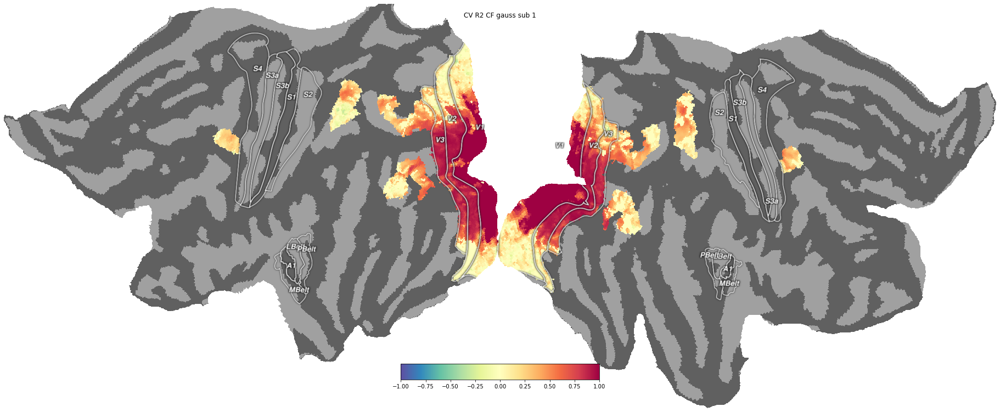

In [274]:
f = cortex.quickshow(cortex.Vertex(CF_gauss1[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-1, vmax=1), with_curvature=True);
f.suptitle(f'CV R2 CF gauss sub {sub}')

Text(0.5, 0.98, 'CV R2 CF norm sub 1')

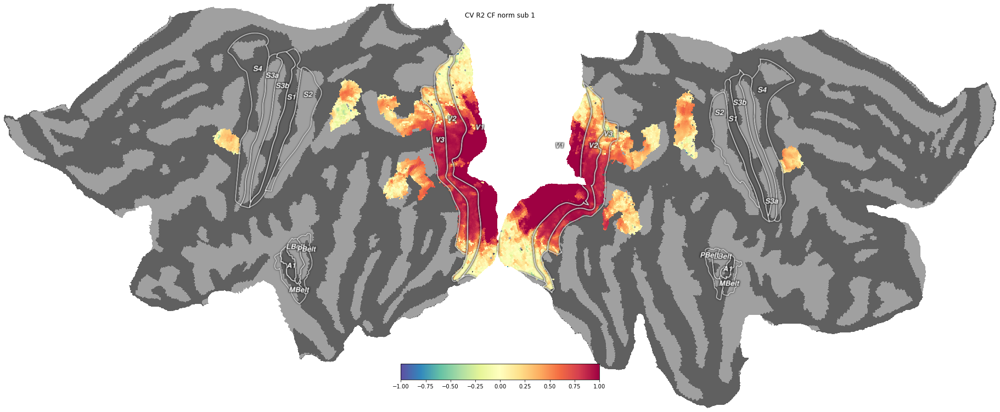

In [275]:
f = cortex.quickshow(cortex.Vertex(CF_norm1[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-1, vmax=1), with_curvature=True);
f.suptitle(f'CV R2 CF norm sub {sub}')

### Cortical space

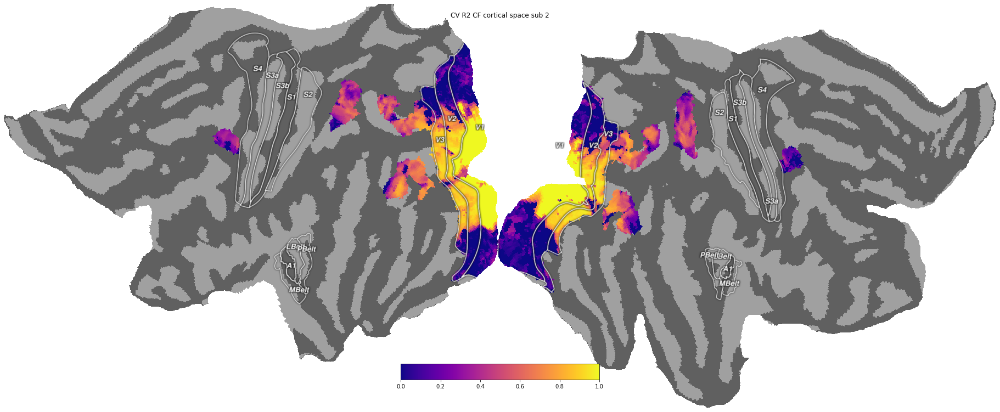

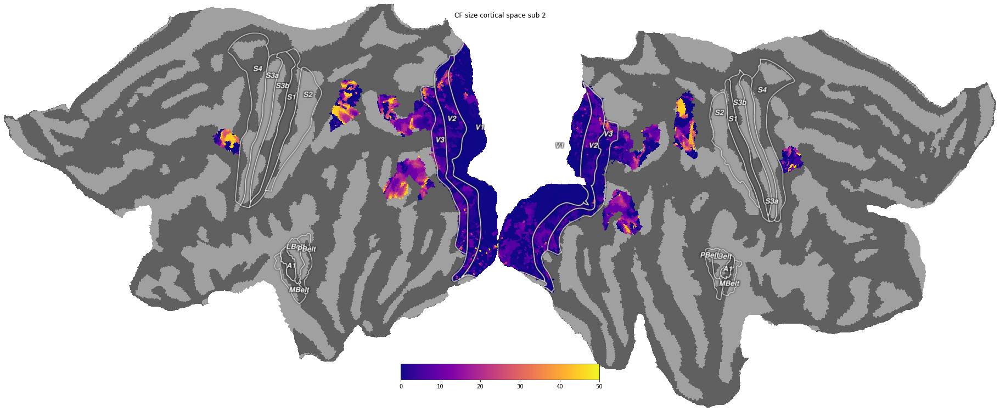

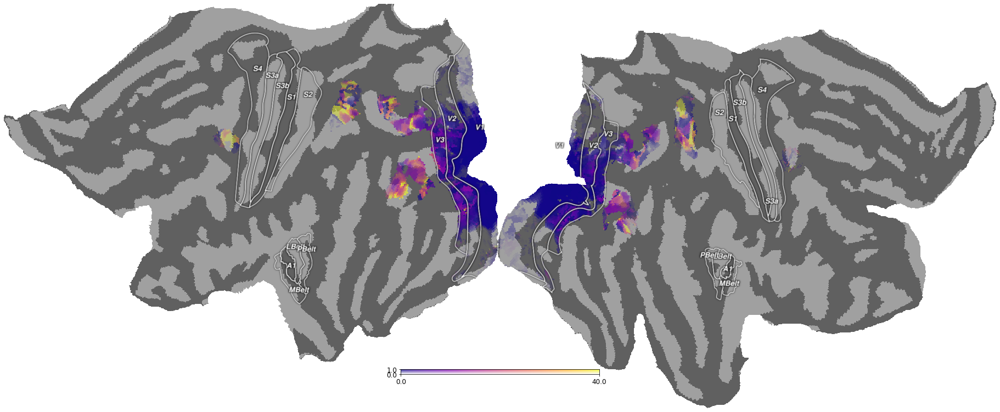

In [47]:
## cortical space
f = cortex.quickshow(cortex.Vertex(CF_cort[:,-1], subject='hcp_999999', cmap='plasma', vmin=0,vmax=1), with_curvature=True);
f.suptitle(f'CV R2 CF cortical space sub {sub}')

f = cortex.quickshow(cortex.Vertex(CF_cort[:,0], subject='hcp_999999', cmap='plasma', vmin=0,vmax=50), with_curvature=True);
f.suptitle(f'CF size cortical space sub {sub}')

alpha_plot(CF_cort[:,0],CF_cort[:,-1],vmax=40,rois=True,cmap='plasma_alpha',colorbar=True,subject='hcp_999999')

# f = cortex.quickshow(cortex.Vertex(spliced_lookup_cort['ecc'].values, subject='hcp_999999', cmap='plasma',vmin=0,vmax=10), with_curvature=True);
# f.suptitle(f'CF cortical space ecc sub {sub}')

# f = cortex.quickshow(cortex.Vertex(spliced_lookup_cort['angle'].values, subject='hcp_999999', cmap='Retinotopy_RYBCR', vmin=-np.pi,vmax=np.pi), with_curvature=True);
# f.suptitle(f'CF cortical space angle sub {sub}')

### Visual space

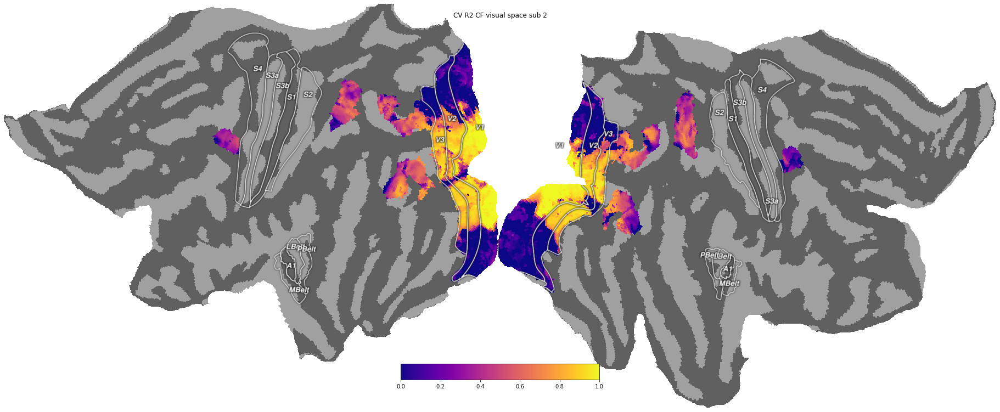

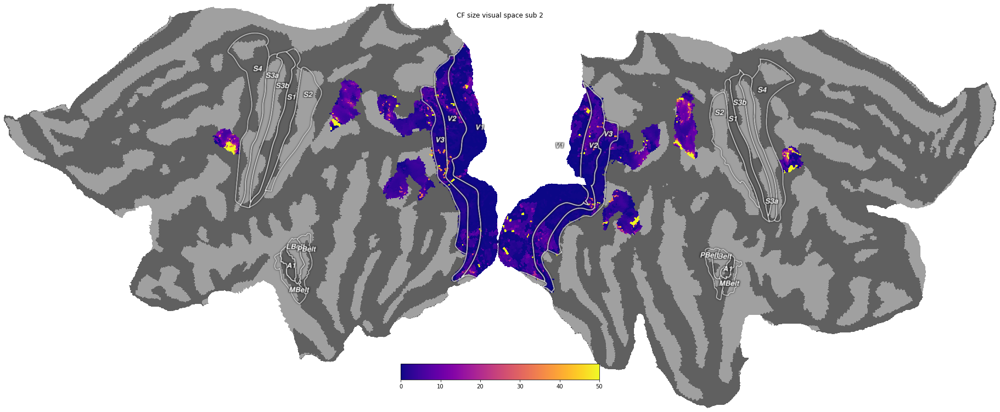

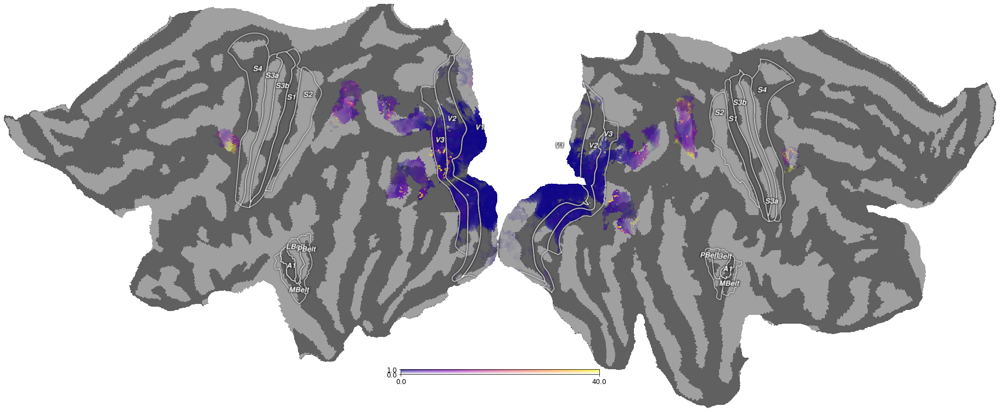

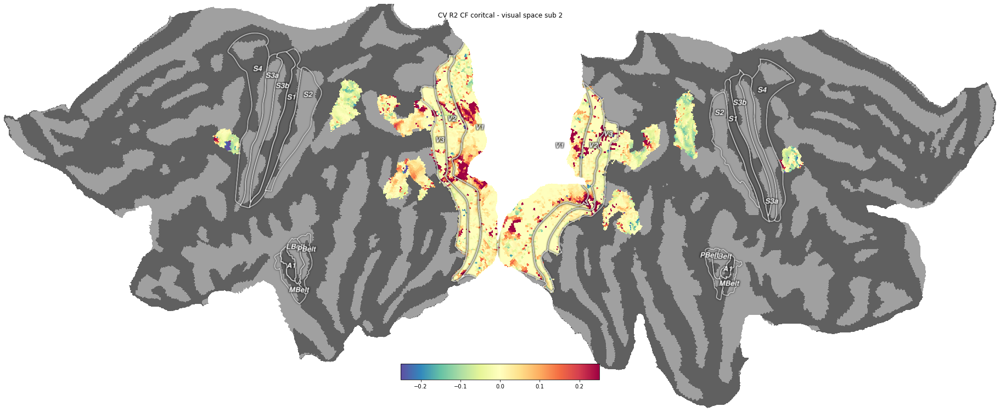

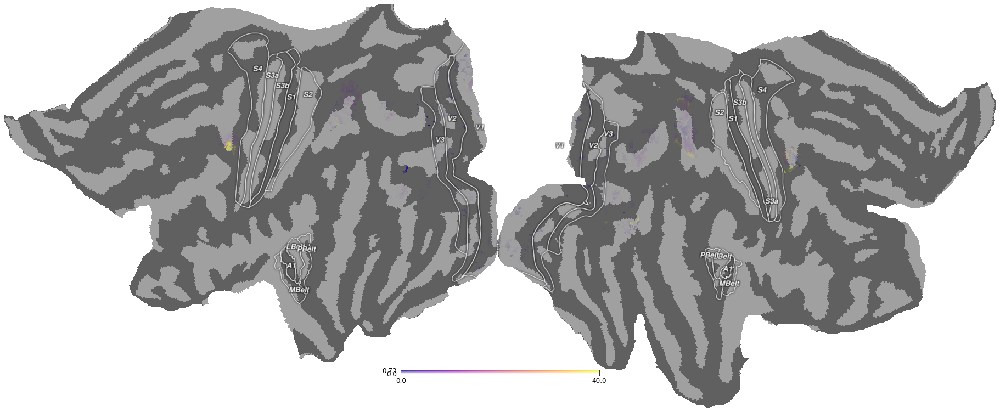

In [48]:
## visual space
f = cortex.quickshow(cortex.Vertex(CF_vis[:,-1], subject='hcp_999999', cmap='plasma',vmin=0,vmax=1), with_curvature=True);
f.suptitle(f'CV R2 CF visual space sub {sub}')

f = cortex.quickshow(cortex.Vertex(CF_vis[:,0], subject='hcp_999999', cmap='plasma', vmin=0,vmax=50), with_curvature=True);
f.suptitle(f'CF size visual space sub {sub}')

alpha_plot(CF_vis[:,0],CF_vis[:,-1],vmax=40,rois=True,cmap='plasma_alpha',colorbar=True,subject='hcp_999999')

# f = cortex.quickshow(cortex.Vertex(spliced_lookup_vis['ecc'].values, subject='hcp_999999', cmap='plasma',vmin=0,vmax=10), with_curvature=True);
# f.suptitle(f'CF visual space ecc sub {sub}')

# f = cortex.quickshow(cortex.Vertex(spliced_lookup_vis['angle'].values, subject='hcp_999999', cmap='Retinotopy_RYBCR', vmin=-np.pi,vmax=np.pi), with_curvature=True);
# f.suptitle(f'CF visual space angle sub {sub}')

## difference in R2
f = cortex.quickshow(cortex.Vertex(CF_cort[:,-1]-CF_vis[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.25, vmax=0.25), with_curvature=True);
f.suptitle(f'CV R2 CF coritcal - visual space sub {sub}')

vis_imp = CF_vis[:,-1] - CF_cort[:,-1]
alpha_plot(CF_vis[:,0],vis_imp,vmax=40,rois=True,cmap='plasma_alpha',colorbar=True,subject='hcp_999999')


Text(0.5, 0.98, 'CV R2 CF cortical - visual space sub 2 zsc')

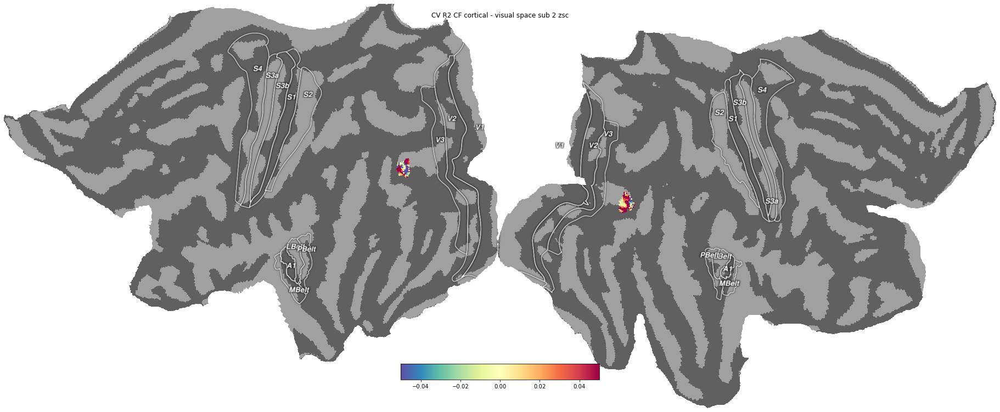

In [124]:
toplot = np.zeros(CF_cort_zsc[:,-1].shape)
toplot[:] = np.nan
diff = CF_cort_zsc[:,-1]-CF_vis_zsc[:,-1]

plotmask = atlas_data_both_hemis == roi_index_dict['LO3']

toplot[plotmask] = diff[plotmask]

f = cortex.quickshow(cortex.Vertex(toplot, subject='hcp_999999', cmap='Spectral_r', vmin=-0.05, vmax=0.05), with_curvature=True);
f.suptitle(f'CV R2 CF cortical - visual space sub {sub} zsc')

/tank/klundert/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:836: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/tank/klundert/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:837: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


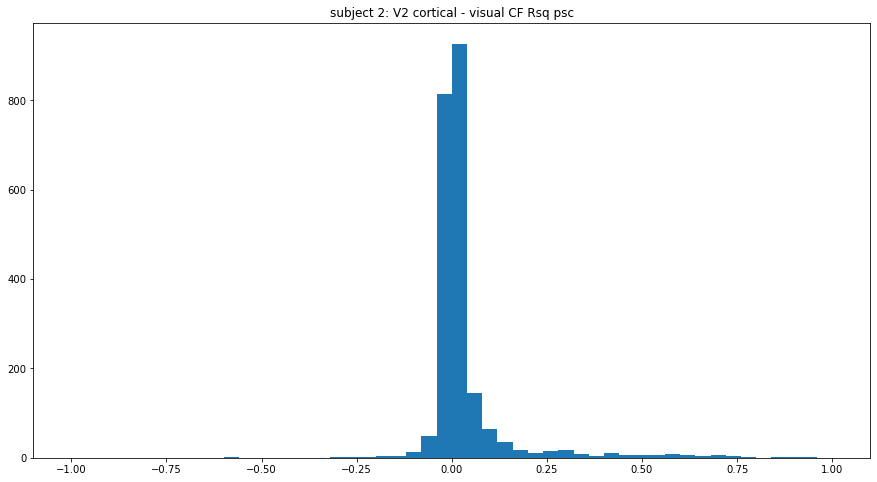

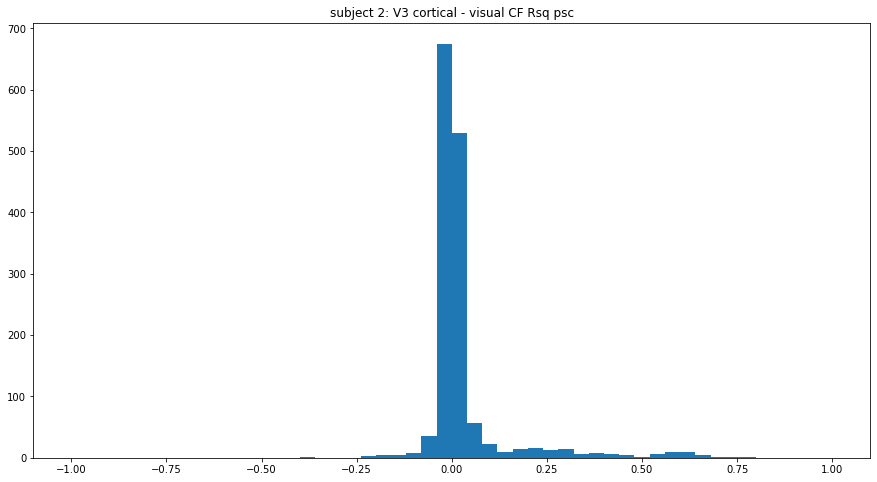

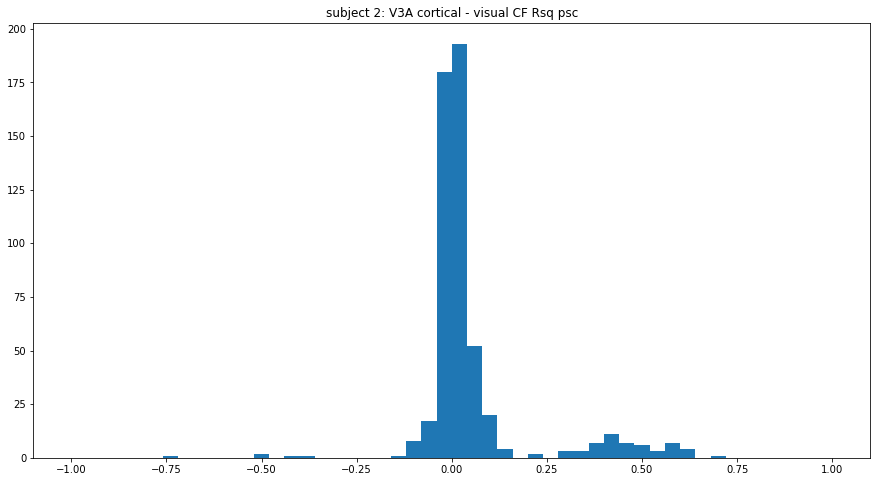

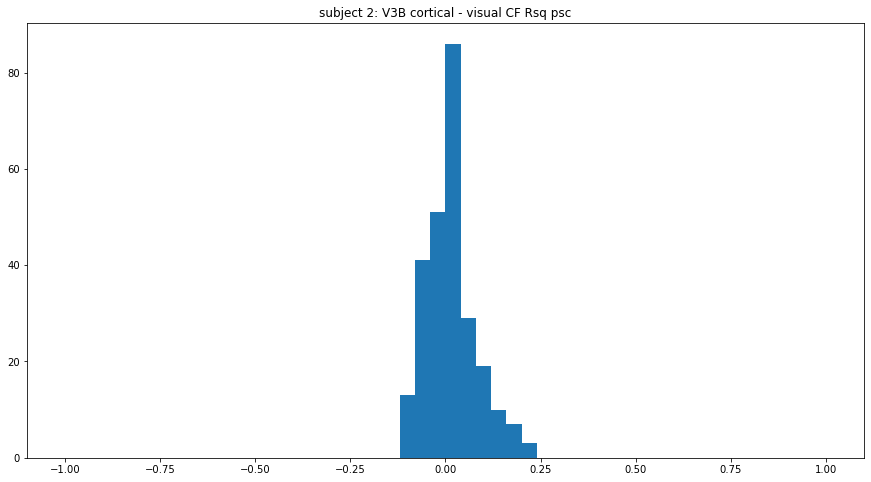

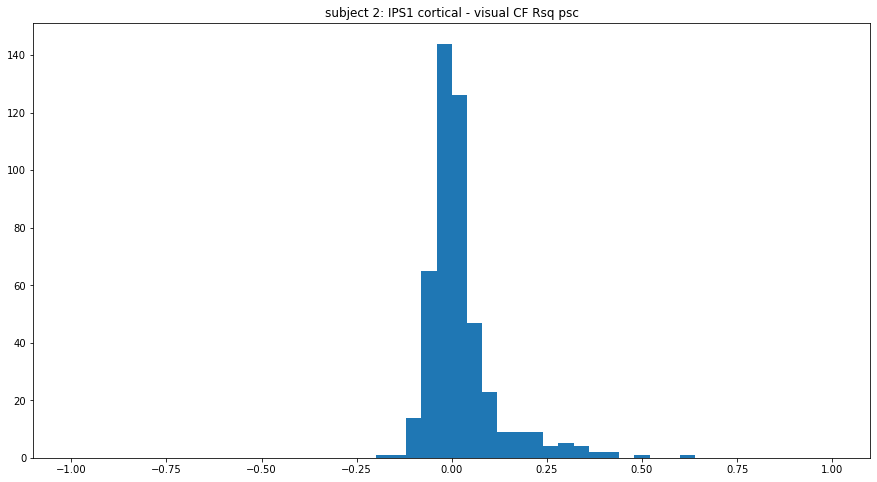

...

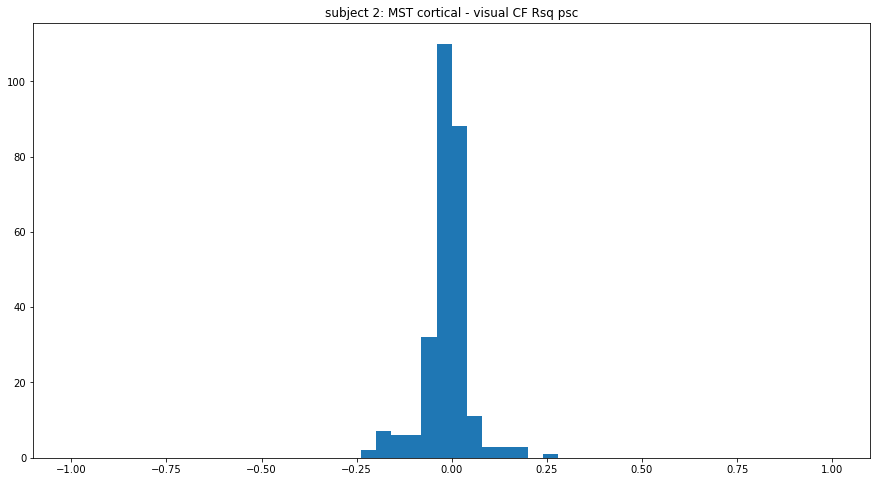

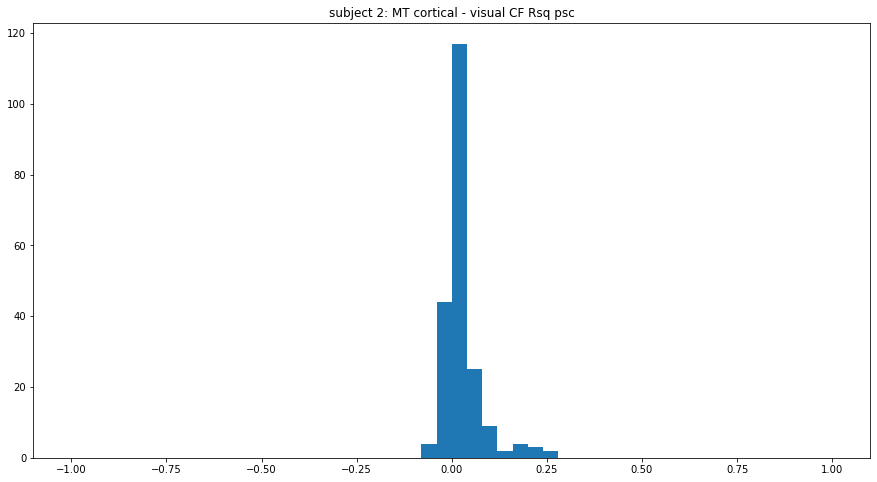

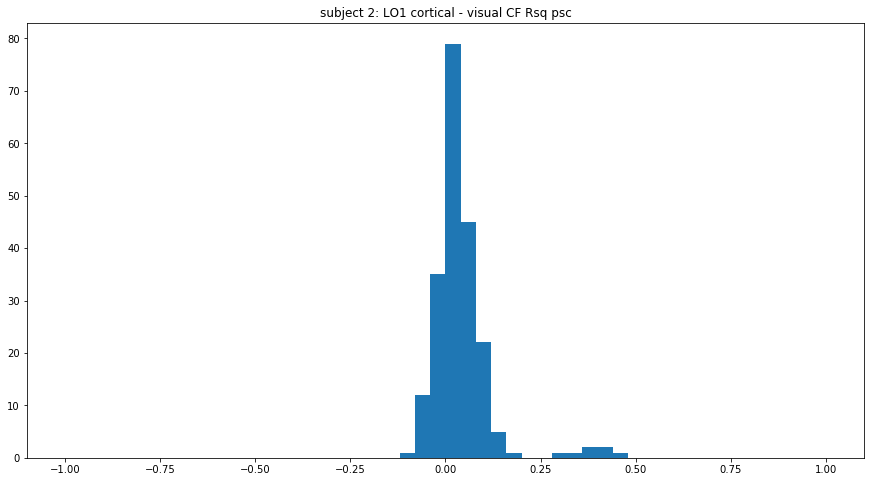

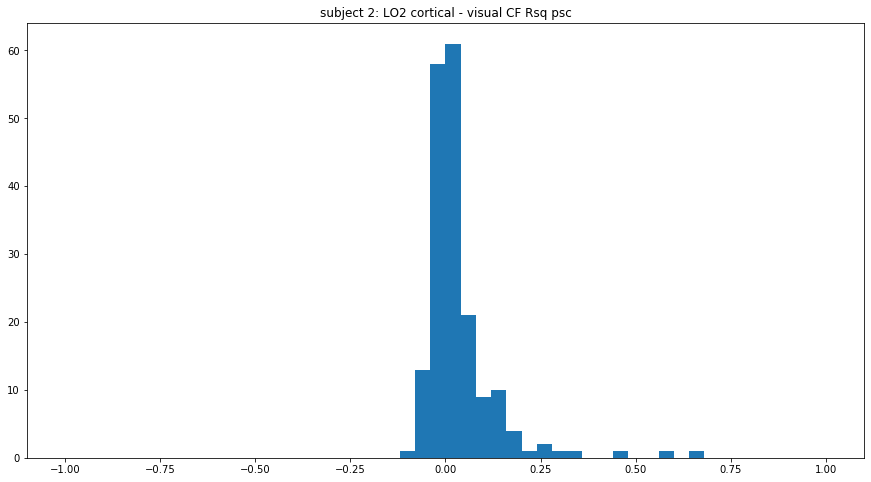

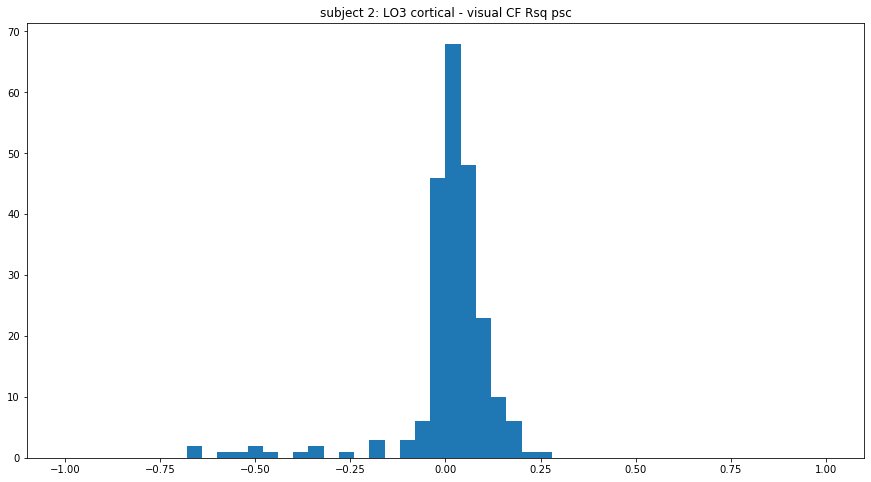

In [64]:
for keys in list(roi_index_dict.keys())[12:]:
    plt.figure(figsize=[15,8])
    roi_mask = atlas_data_both_hemis == roi_index_dict[keys]
    
    plt.hist(CF_cort[:,-1][roi_mask]-CF_vis[:,-1][roi_mask], bins=50, range=[-1,1])
#     plt.hist(CF_vis_zsc[:,-1][roi_mask], alpha=0.5, label='visual space, median = ' +str(np.nanmedian(CF_vis_zsc[:,-1][roi_mask])), bins=50, range=[-1,1])
    
#     plt.legend(loc='upper left')
    plt.title('subject 2: ' + str(keys) + ' cortical - visual CF Rsq psc')

### psc vs z-scored


Text(0.5, 0.98, 'CV R2 difference psc-zsc visual space 2')

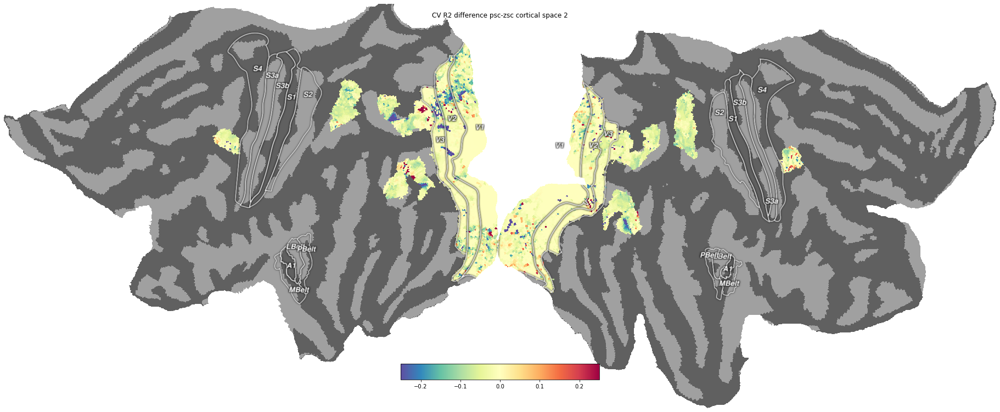

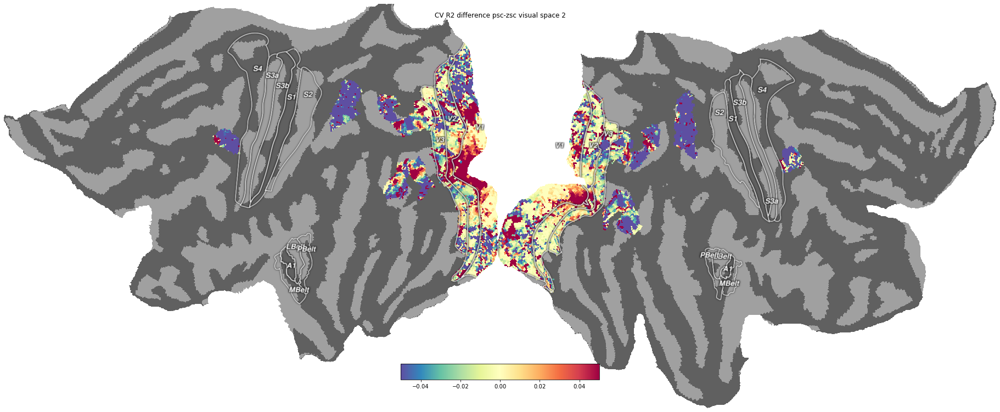

In [197]:
## psc vs z-scored
f = cortex.quickshow(cortex.Vertex(CF_cort[:,-1]-CF_cort_zsc[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.25, vmax=0.25), with_curvature=True);
f.suptitle(f'CV R2 difference psc-zsc cortical space {sub}')

f = cortex.quickshow(cortex.Vertex(CF_cort[:,-1]-CF_vis_zsc[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.05, vmax=0.05), with_curvature=True);
f.suptitle(f'CV R2 difference psc-zsc visual space {sub}')

/tank/klundert/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:836: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/tank/klundert/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:837: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


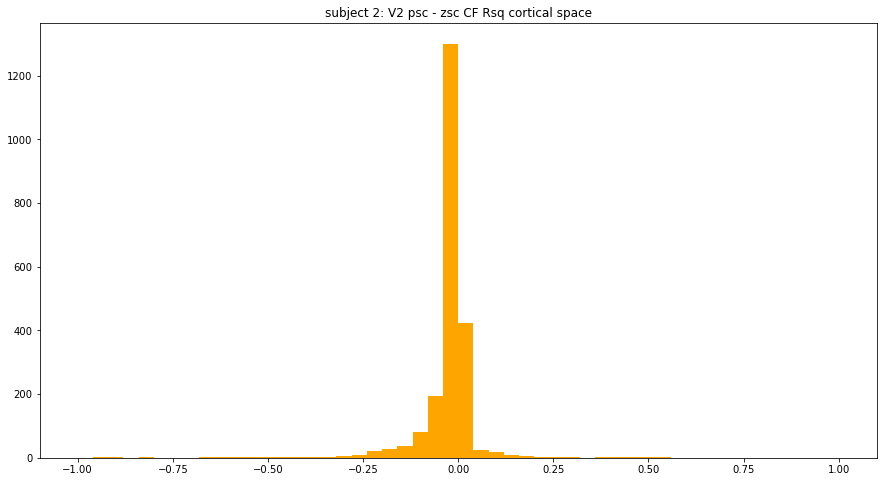

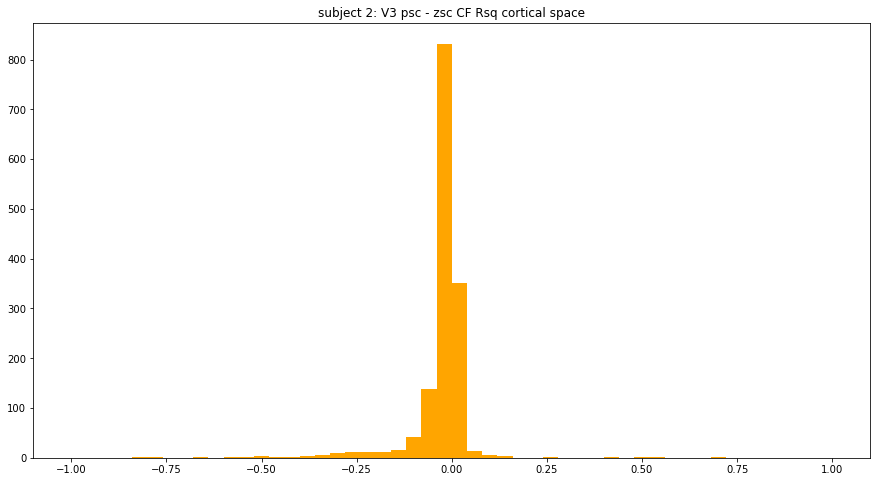

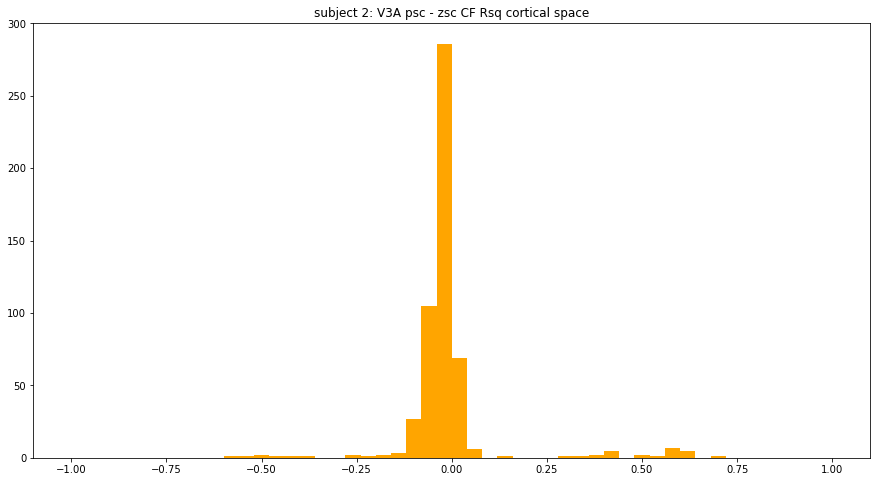

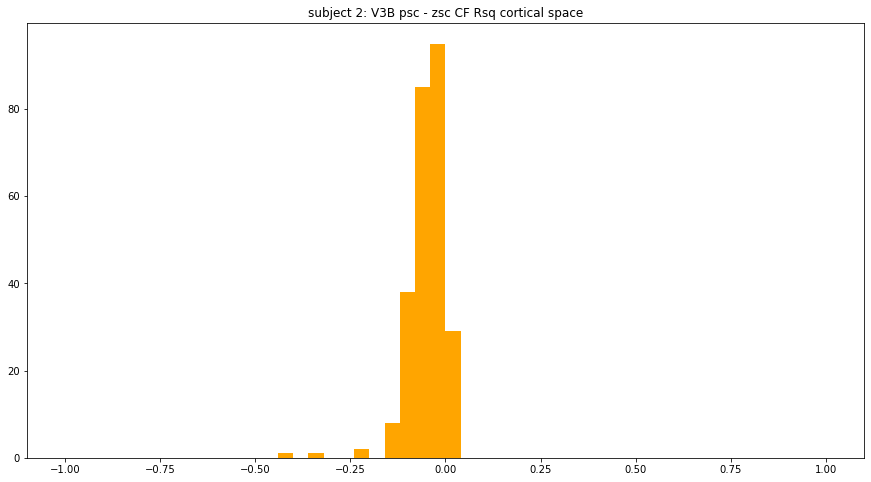

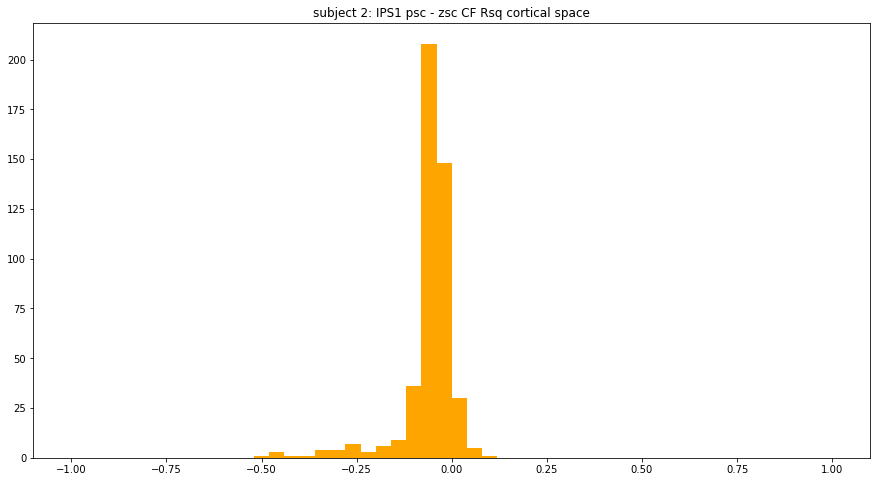

...

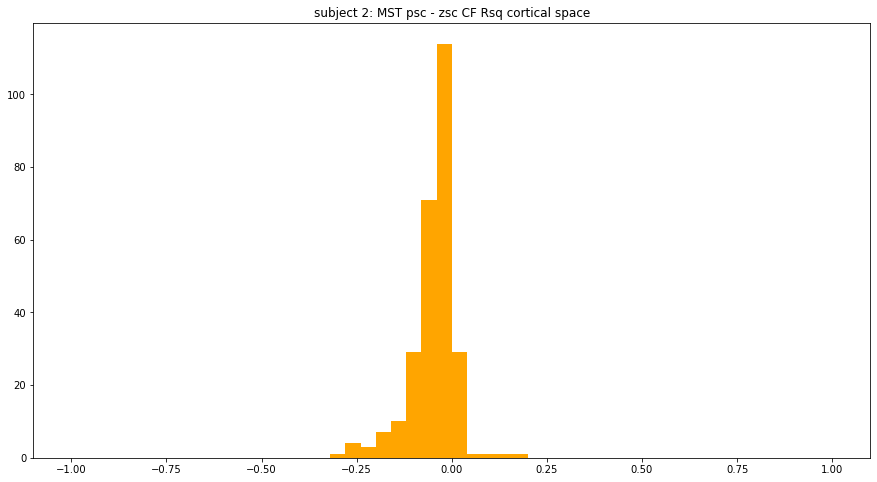

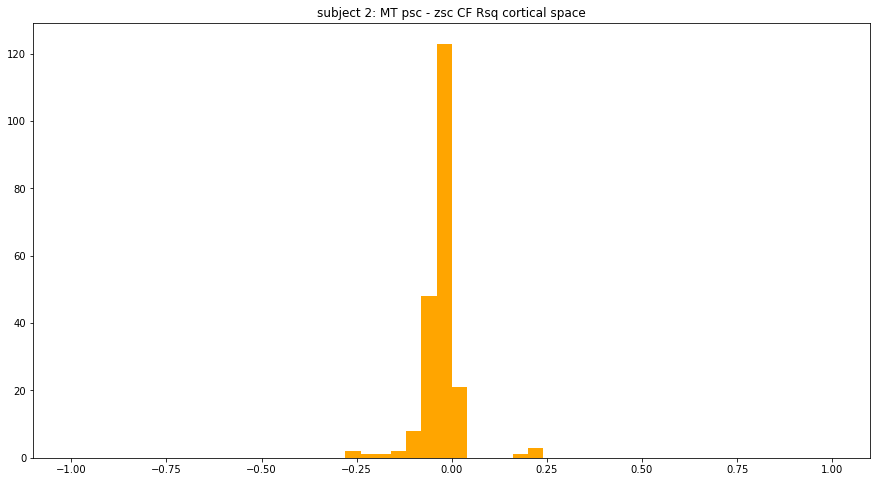

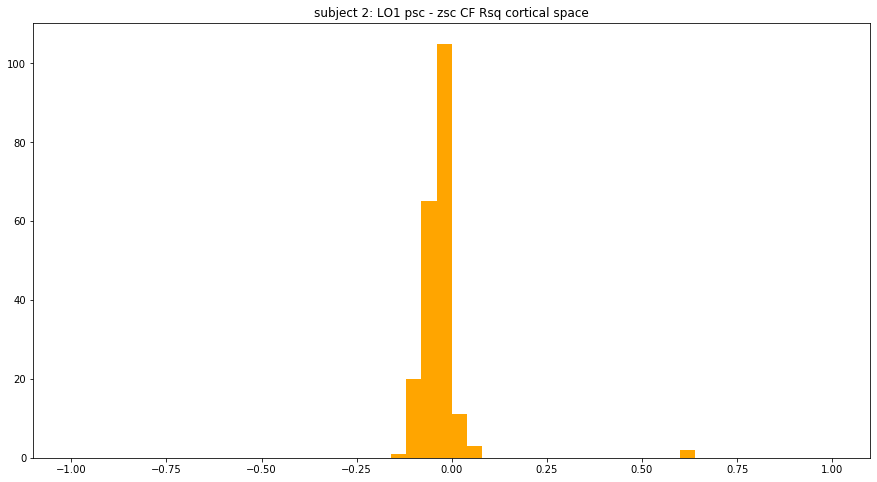

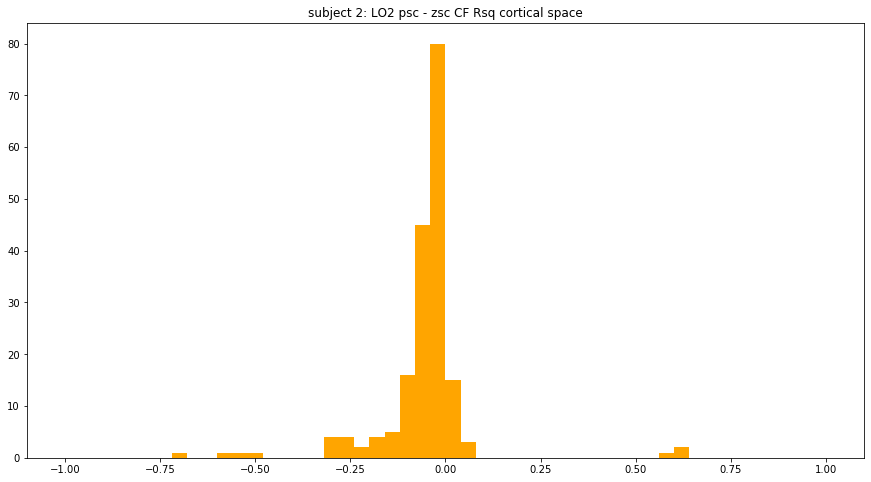

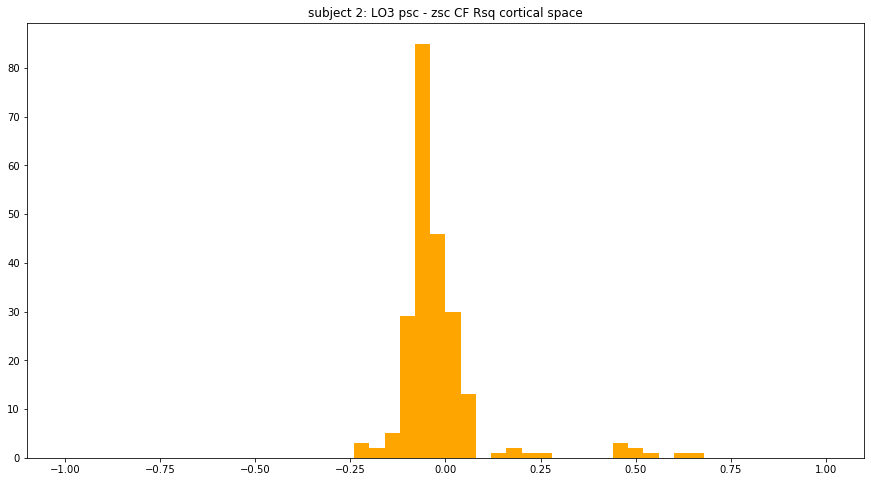

In [63]:
for keys in list(roi_index_dict.keys())[12:]:
    plt.figure(figsize=[15,8])
    roi_mask = atlas_data_both_hemis == roi_index_dict[keys]
    plt.hist(CF_cort[:,-1][roi_mask]-CF_cort_zsc[:,-1][roi_mask], bins=50, range=[-1,1], color='orange')
#     plt.hist(CF_vis_zsc[:,-1][roi_mask], alpha=0.5, label='zsc, median = ' +str(np.nanmedian(CF_vis_zsc[:,-1][roi_mask])), bins=50, range=[-1,1])
    
#     plt.legend(loc='upper left')
    plt.title('subject 2: ' + str(keys) + ' psc - zsc CF Rsq cortical space')


### prf fits and R2 difference between norm and gauss and CF and pRF

Text(0.5, 0.98, 'CV R2 gauss CF (cortical) - norm pRF sub 2')

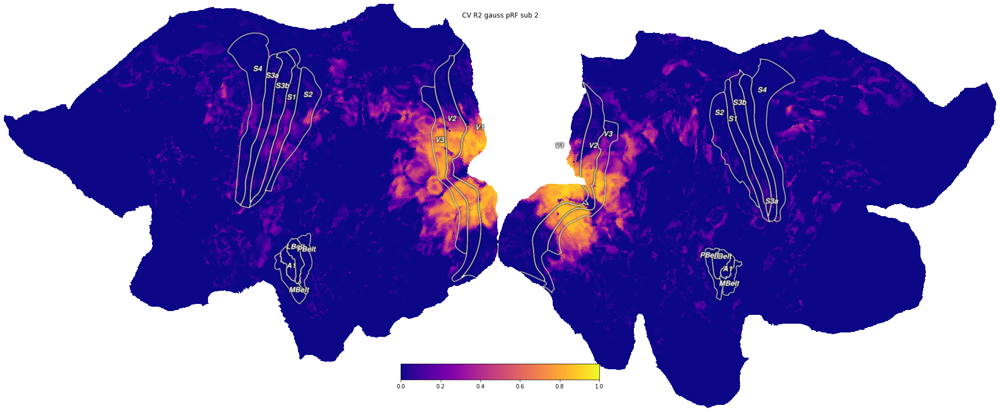

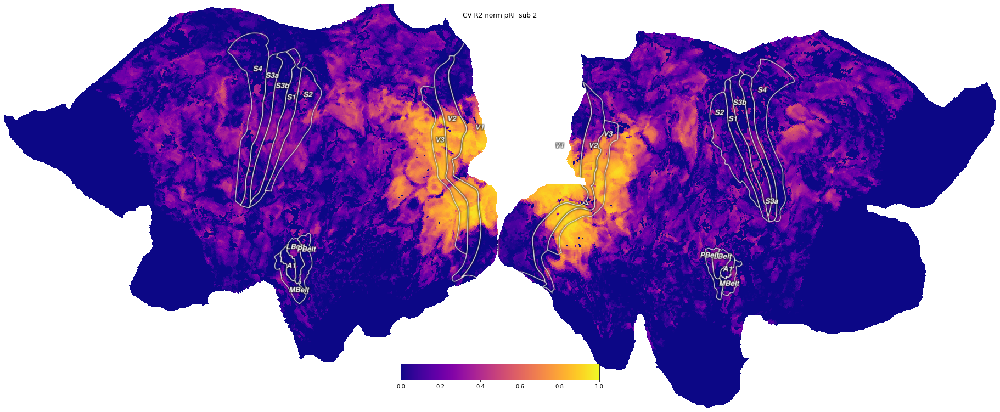

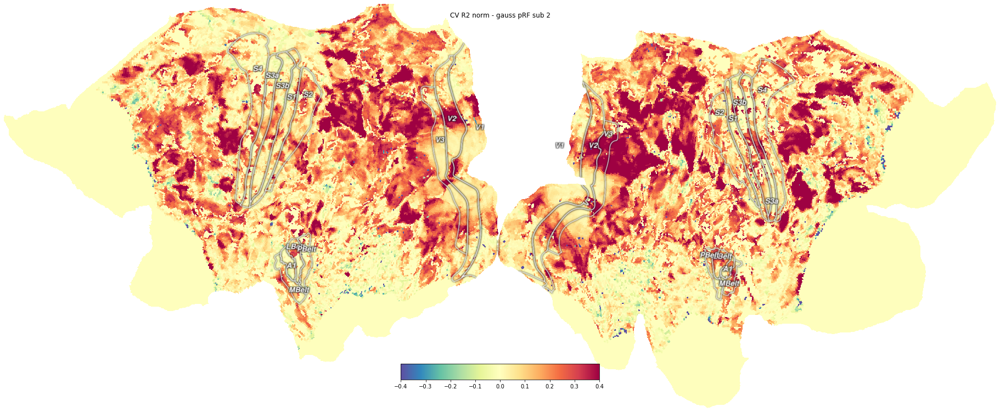

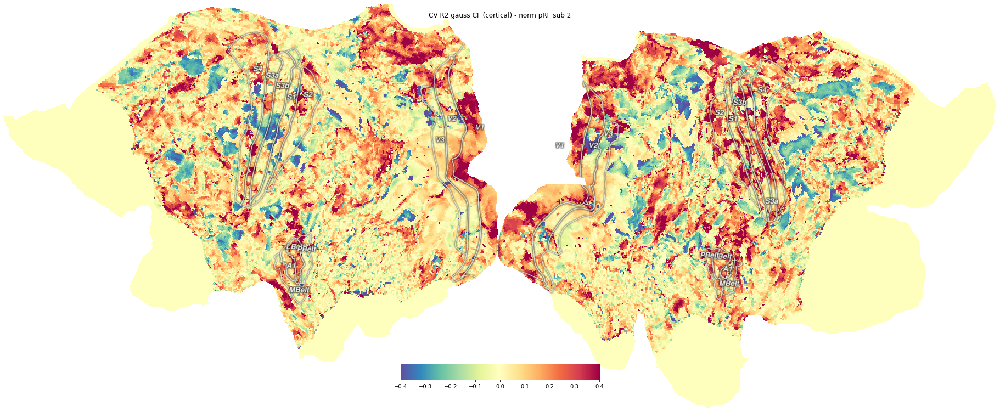

In [60]:
## prf fits and R2 difference between norm and gauss and CF and pRF

f = cortex.quickshow(cortex.Vertex(gauss_prf[:,-1], subject='hcp_999999', cmap='plasma', vmin=0, vmax=1), with_curvature=True);
f.suptitle(f'CV R2 gauss pRF sub {sub}')

f = cortex.quickshow(cortex.Vertex(norm_prf[:,-1], subject='hcp_999999', cmap='plasma', vmin=0, vmax=1), with_curvature=True);
f.suptitle(f'CV R2 norm pRF sub {sub}')

f = cortex.quickshow(cortex.Vertex(norm_prf[:,-1]-gauss_prf[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.4, vmax=0.4), with_curvature=True);
f.suptitle(f'CV R2 norm - gauss pRF sub {sub}')

f = cortex.quickshow(cortex.Vertex(CF_cort[:,-1]-norm_prf[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.4, vmax=0.4), with_curvature=True);
f.suptitle(f'CV R2 gauss CF (cortical) - norm pRF sub {sub}')

## SUB1:

In [90]:
CF_cort = np.zeros((118584, 5))
CF_cort[:] = np.nan

CF_cort_zsc = np.zeros((118584, 5))
CF_cort_zsc[:] = np.nan

CF_vis = np.zeros((118584, 5))
CF_vis[:] = np.nan

CF_vis_zsc = np.zeros((118584, 5))
CF_vis_zsc[:] = np.nan

In [91]:
fold = 1
sub = 1

gauss_prf = get_cortex(np.load(f'/scratch/2021/nprf_ss/derivatives/prf-fits/sub-0{sub}/gaussian-prf/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gaussPRF_params_cv_fold{fold}.npy'))
norm_prf = get_cortex(np.load(f'/scratch/2021/nprf_ss/derivatives/prf-fits/sub-0{sub}/dn-prf/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_normPRF_params_cv_fold{fold}.npy'))

CF_cort[boolmask] = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/cortical_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_cortical_space_fold{fold}.npy')
CF_vis[boolmask] = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/visual_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_visual_space_fold{fold}.npy')

CF_cort_zsc[boolmask] = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/cortical_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_cortical_space_fold{fold}_zsc.npy')
CF_vis_zsc[boolmask] = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/visual_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_visual_space_fold{fold}_zsc.npy')


# gfn_ecc = ecc(gauss_prf[:,0], gauss_prf[:,1])
# gfn_angle = angle(gauss_prf[:,0], gauss_prf[:,1])

# d = {'ecc': gfn_ecc, 'angle': gfn_angle}
# ret_frame = pd.DataFrame(data=d)
# spliced_lookup_vis=ret_frame.iloc[CF_vis[:,3].astype(int),:]
# spliced_lookup_cort=ret_frame.iloc[CF_cort[:,3].astype(int),:]

### Cortical space

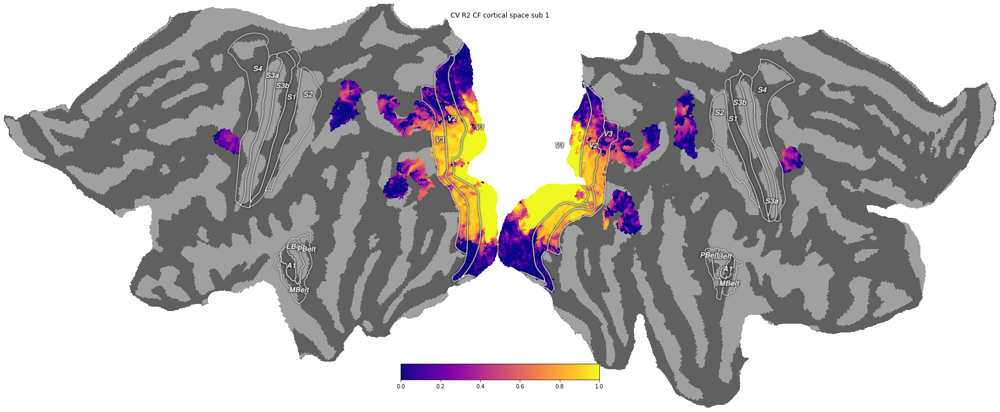

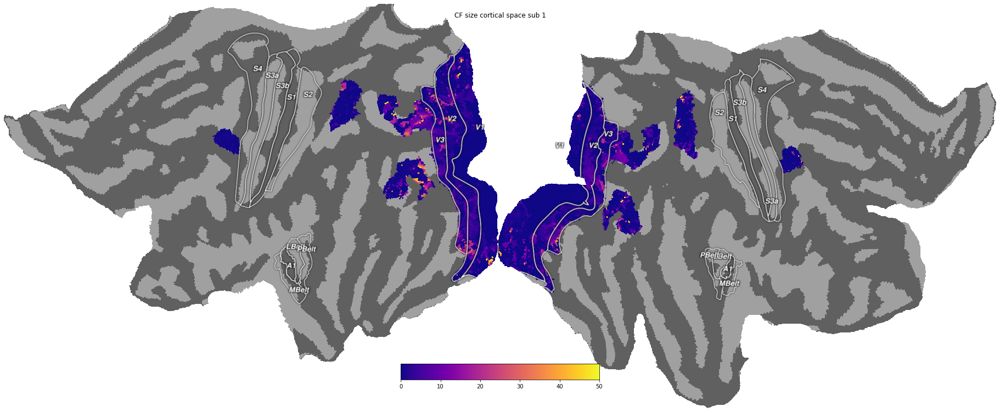

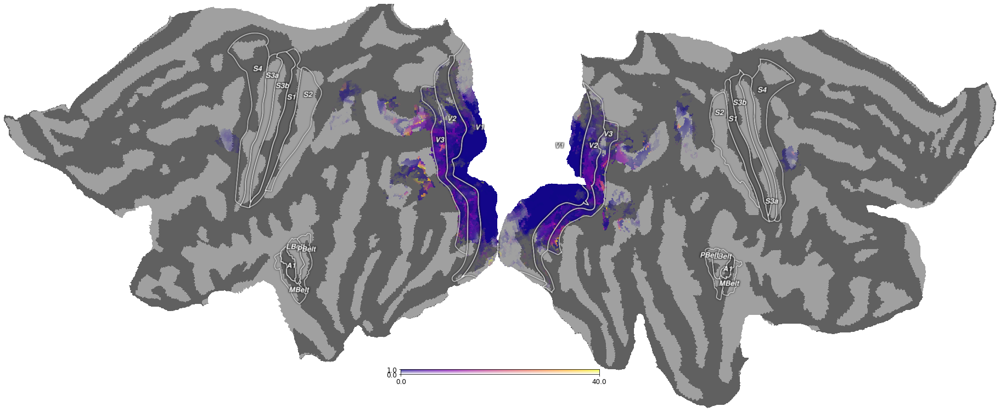

In [54]:
## cortical space
f = cortex.quickshow(cortex.Vertex(CF_cort[:,-1], subject='hcp_999999', cmap='plasma', vmin=0,vmax=1), with_curvature=True);
f.suptitle(f'CV R2 CF cortical space sub {sub}')

f = cortex.quickshow(cortex.Vertex(CF_cort[:,0], subject='hcp_999999', cmap='plasma', vmin=0,vmax=50), with_curvature=True);
f.suptitle(f'CF size cortical space sub {sub}')

alpha_plot(CF_cort[:,0],CF_cort[:,-1],vmax=40,rois=True,cmap='plasma_alpha',colorbar=True,subject='hcp_999999')

# f = cortex.quickshow(cortex.Vertex(spliced_lookup_cort['ecc'].values, subject='hcp_999999', cmap='plasma',vmin=0,vmax=10), with_curvature=True);
# f.suptitle(f'CF cortical space ecc sub {sub}')

# f = cortex.quickshow(cortex.Vertex(spliced_lookup_cort['angle'].values, subject='hcp_999999', cmap='Retinotopy_RYBCR', vmin=-np.pi,vmax=np.pi), with_curvature=True);
# f.suptitle(f'CF cortical space angle sub {sub}')


### Visual space

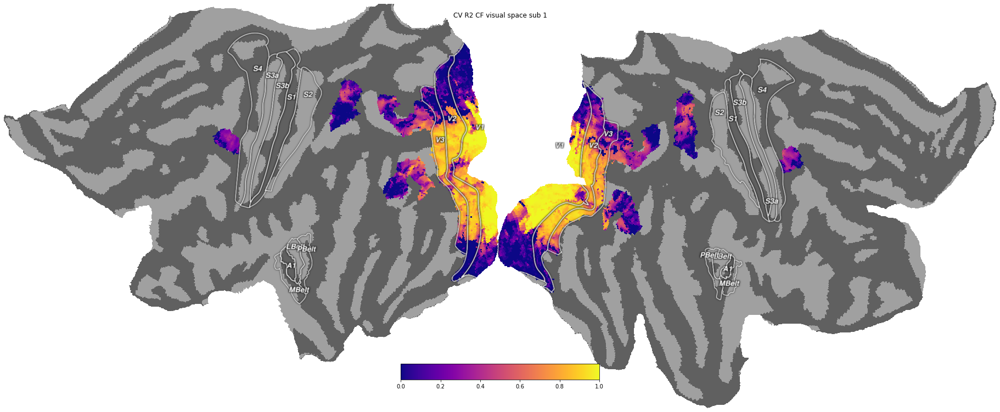

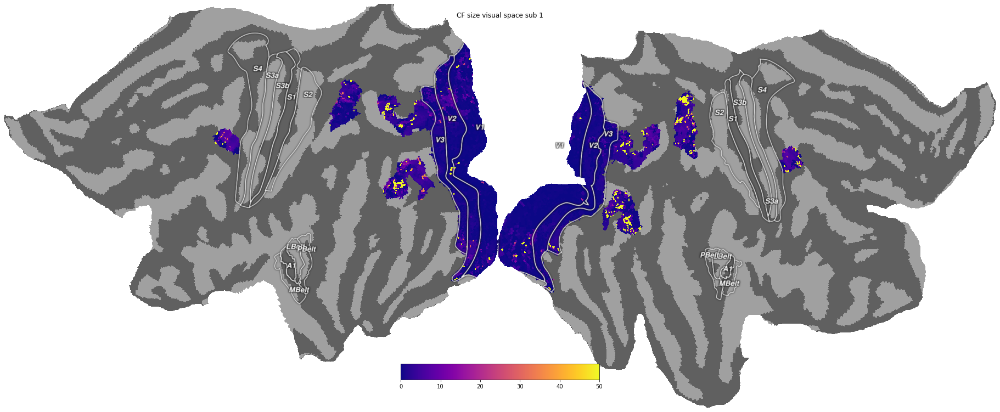

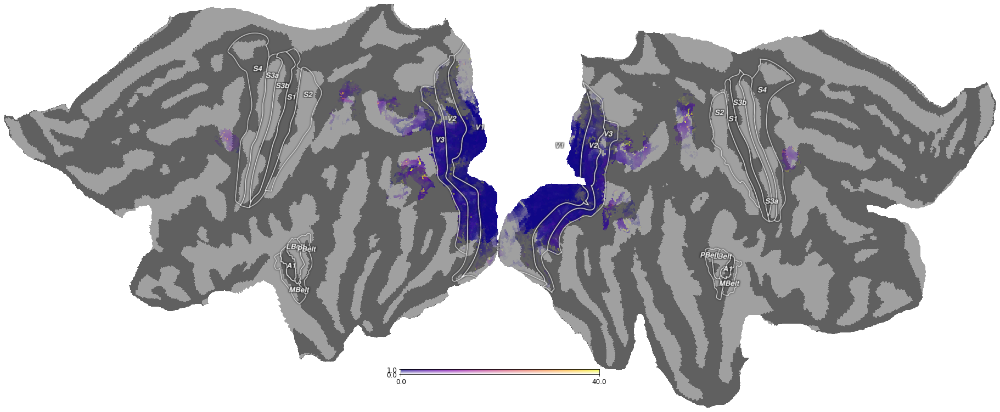

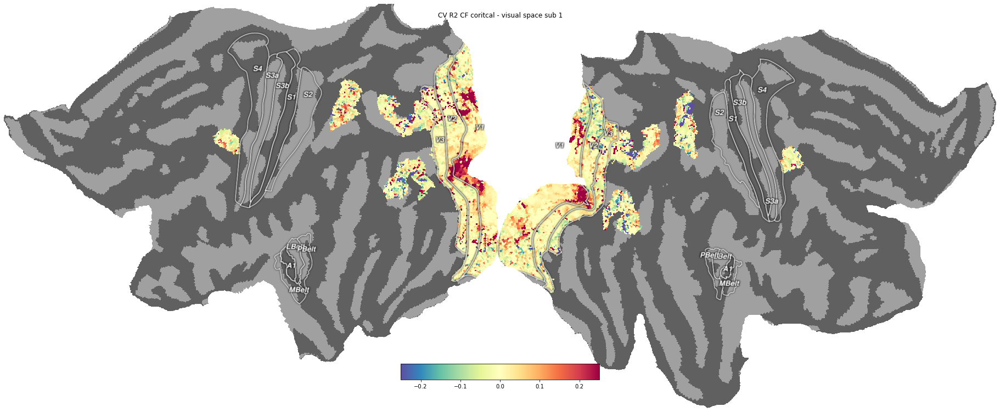

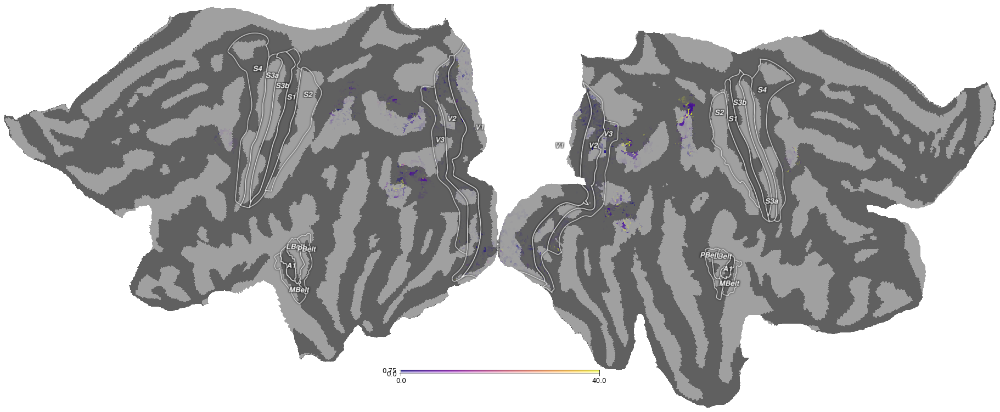

In [55]:
## visual space
f = cortex.quickshow(cortex.Vertex(CF_vis[:,-1], subject='hcp_999999', cmap='plasma',vmin=0,vmax=1), with_curvature=True);
f.suptitle(f'CV R2 CF visual space sub {sub}')

f = cortex.quickshow(cortex.Vertex(CF_vis[:,0], subject='hcp_999999', cmap='plasma', vmin=0,vmax=50), with_curvature=True);
f.suptitle(f'CF size visual space sub {sub}')

alpha_plot(CF_vis[:,0],CF_vis[:,-1],vmax=40,rois=True,cmap='plasma_alpha',colorbar=True,subject='hcp_999999')

# f = cortex.quickshow(cortex.Vertex(spliced_lookup_vis['ecc'].values, subject='hcp_999999', cmap='plasma',vmin=0,vmax=10), with_curvature=True);
# f.suptitle(f'CF visual space ecc sub {sub}')

# f = cortex.quickshow(cortex.Vertex(spliced_lookup_vis['angle'].values, subject='hcp_999999', cmap='Retinotopy_RYBCR', vmin=-np.pi,vmax=np.pi), with_curvature=True);
# f.suptitle(f'CF visual space angle sub {sub}')

## difference in R2
f = cortex.quickshow(cortex.Vertex(CF_cort[:,-1]-CF_vis[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.25, vmax=0.25), with_curvature=True);
f.suptitle(f'CV R2 CF coritcal - visual space sub {sub}')

vis_imp = CF_vis[:,-1] - CF_cort[:,-1]
alpha_plot(CF_vis[:,0],vis_imp,vmax=40,rois=True,cmap='plasma_alpha',colorbar=True,subject='hcp_999999')


Text(0.5, 0.98, 'CV R2 CF cortical - visual space sub 1 zsc')

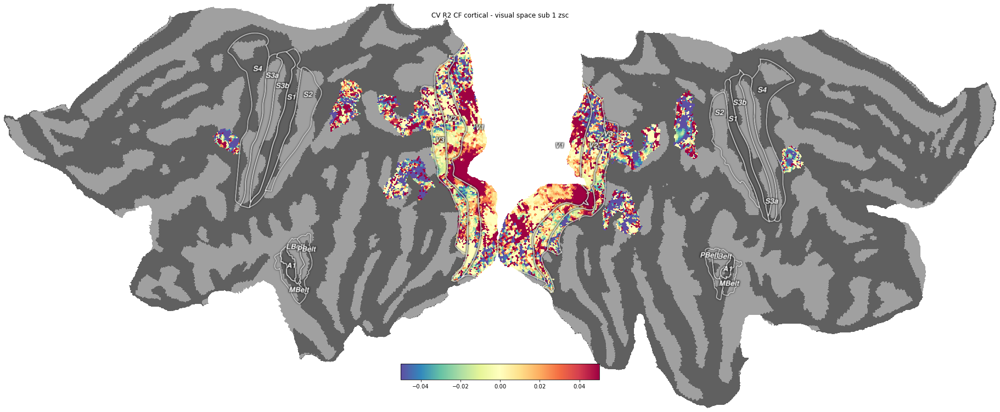

In [93]:
f = cortex.quickshow(cortex.Vertex(CF_cort_zsc[:,-1]-CF_vis_zsc[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.05, vmax=0.05), with_curvature=True);
f.suptitle(f'CV R2 CF cortical - visual space sub {sub} zsc')

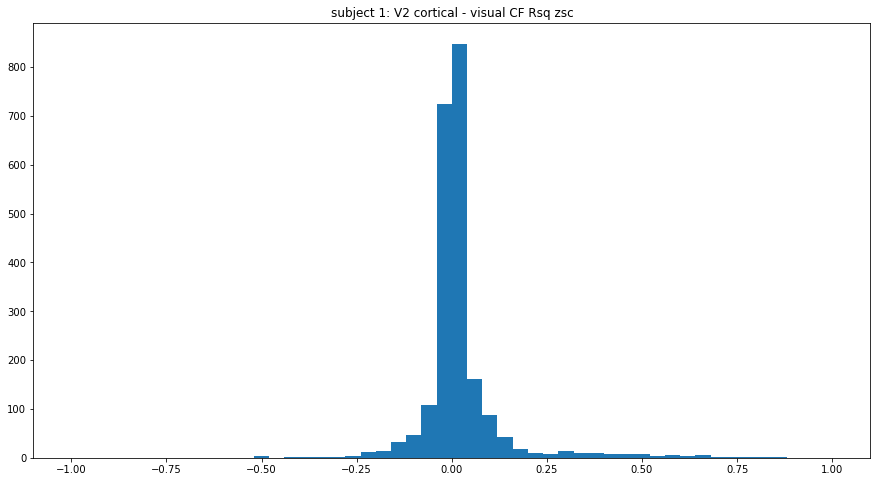

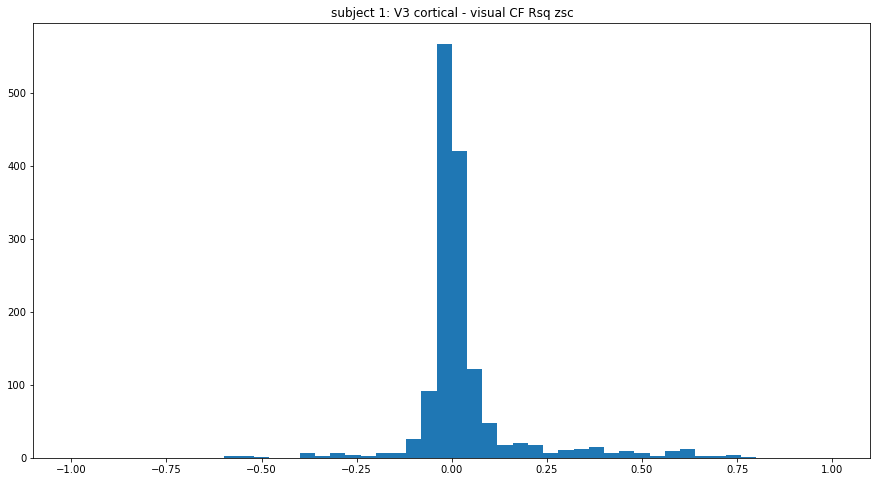

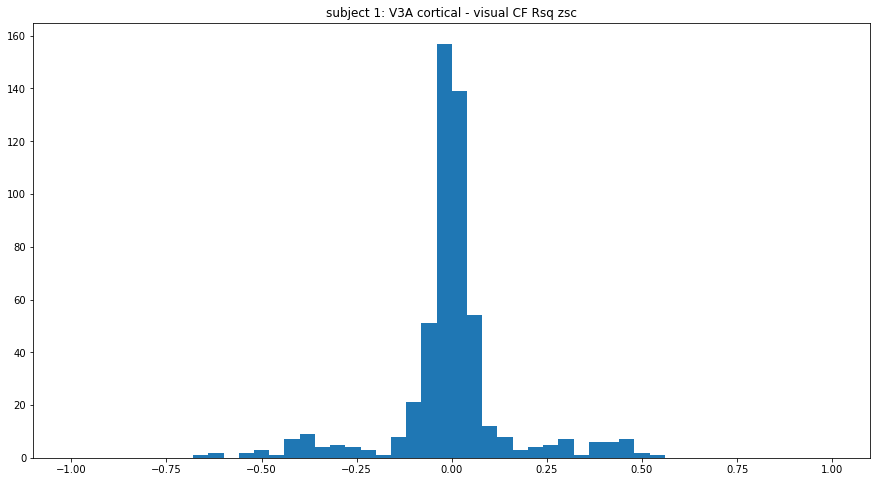

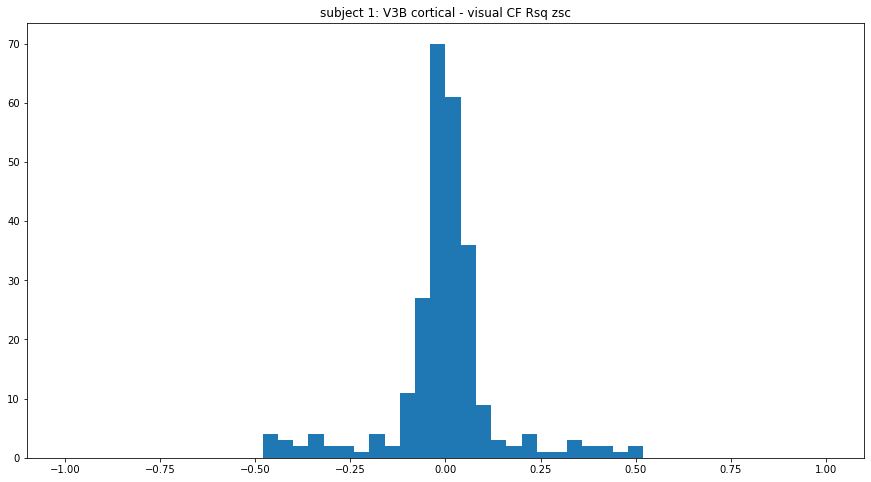

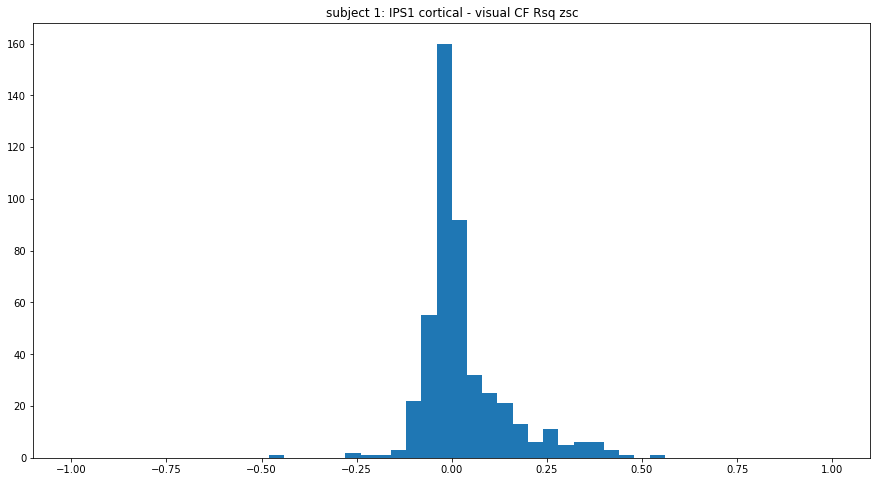

...

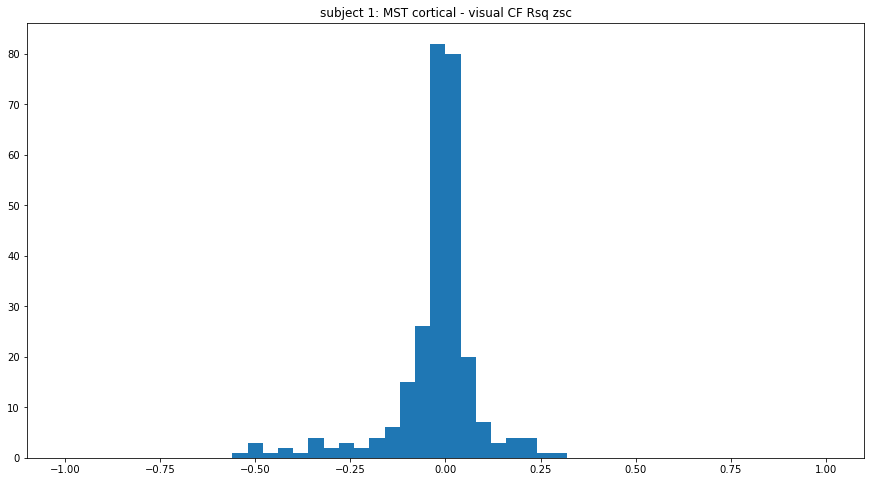

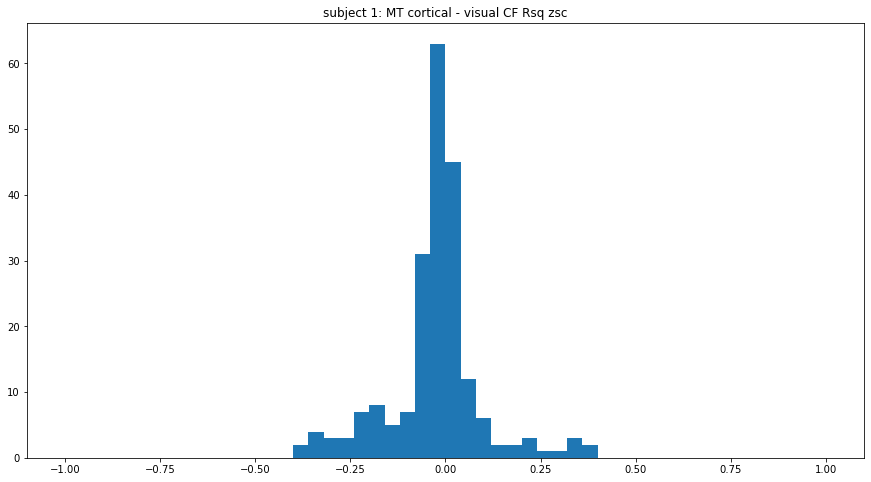

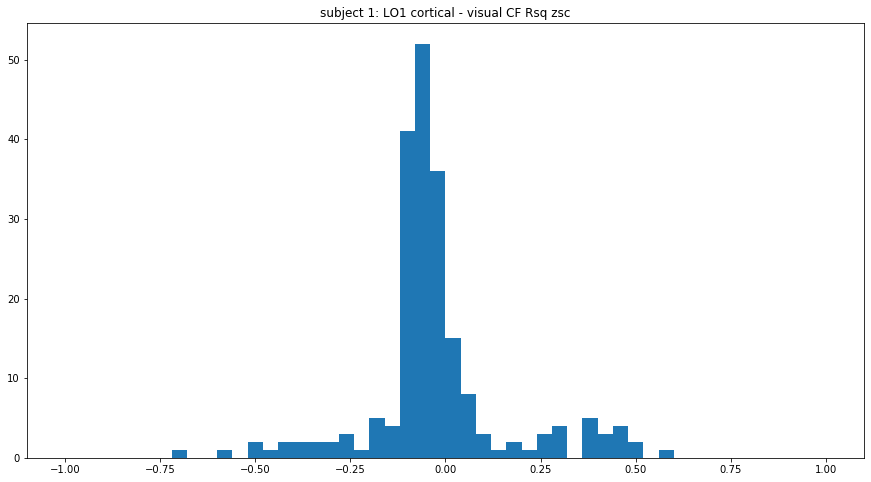

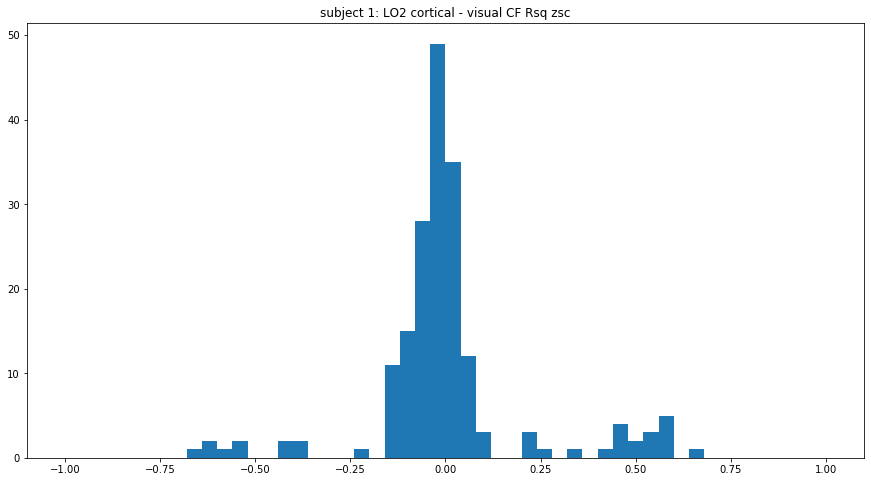

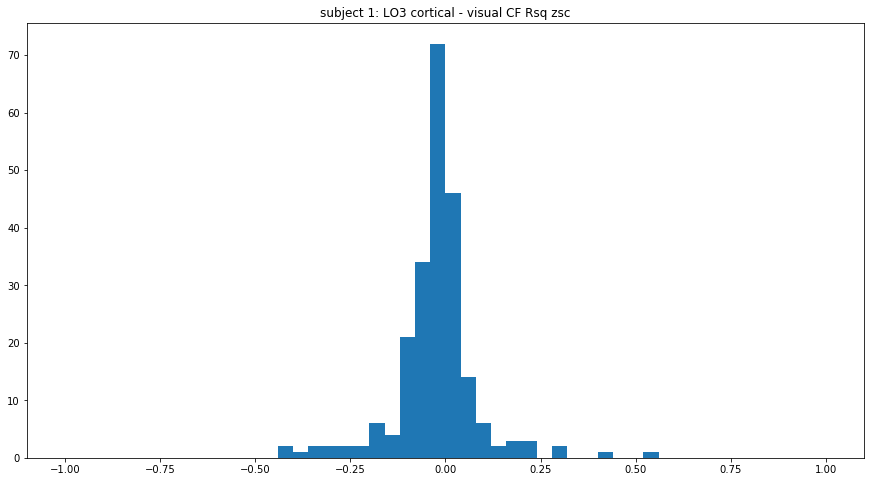

In [83]:
for keys in list(roi_index_dict.keys())[12:]:
    plt.figure(figsize=[15,8])
    roi_mask = atlas_data_both_hemis == roi_index_dict[keys]
    
    plt.hist(CF_cort_zsc[:,-1][roi_mask]-CF_vis_zsc[:,-1][roi_mask], bins=50, range=[-1,1])
#     plt.hist(CF_vis_zsc[:,-1][roi_mask], alpha=0.5, label='visual space, median = ' +str(np.nanmedian(CF_vis_zsc[:,-1][roi_mask])), bins=50, range=[-1,1])
    
#     plt.legend(loc='upper left')
    plt.title('subject 1: ' + str(keys) + ' cortical - visual CF Rsq zsc')

### psc vs z-scored

Text(0.5, 0.98, 'CV R2 difference psc-zsc visual space 1')

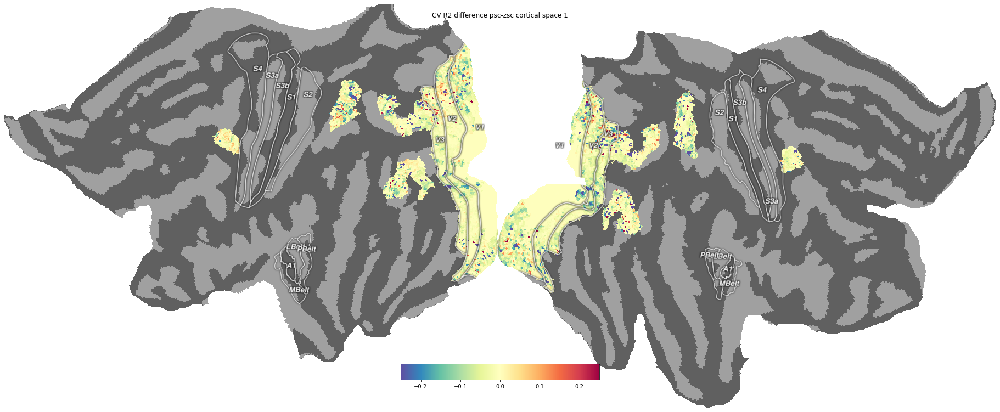

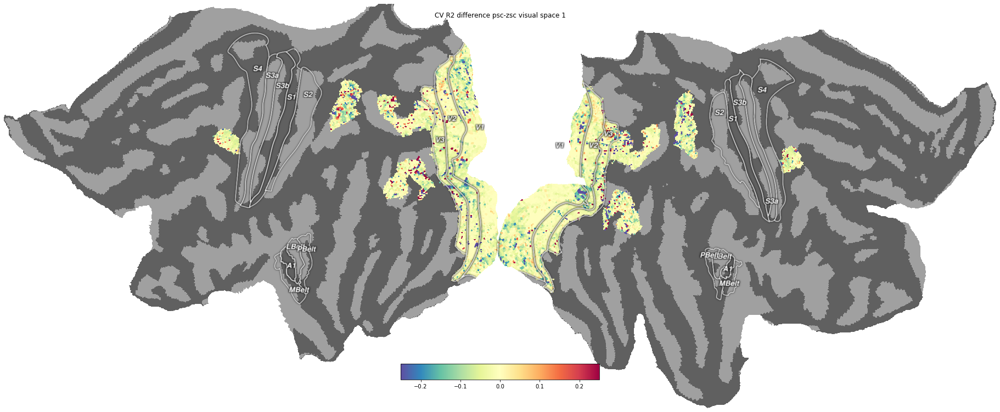

In [52]:
## psc vs z-scored
f = cortex.quickshow(cortex.Vertex(CF_cort[:,-1]-CF_cort_zsc[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.25, vmax=0.25), with_curvature=True);
f.suptitle(f'CV R2 difference psc-zsc cortical space {sub}')

f = cortex.quickshow(cortex.Vertex(CF_vis[:,-1]-CF_vis_zsc[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.25, vmax=0.25), with_curvature=True);
f.suptitle(f'CV R2 difference psc-zsc visual space {sub}')

/tank/klundert/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:836: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/tank/klundert/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:837: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


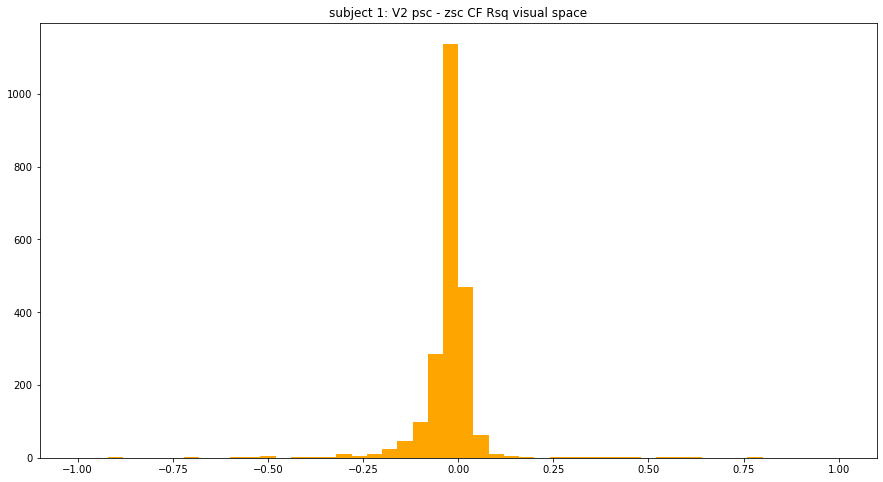

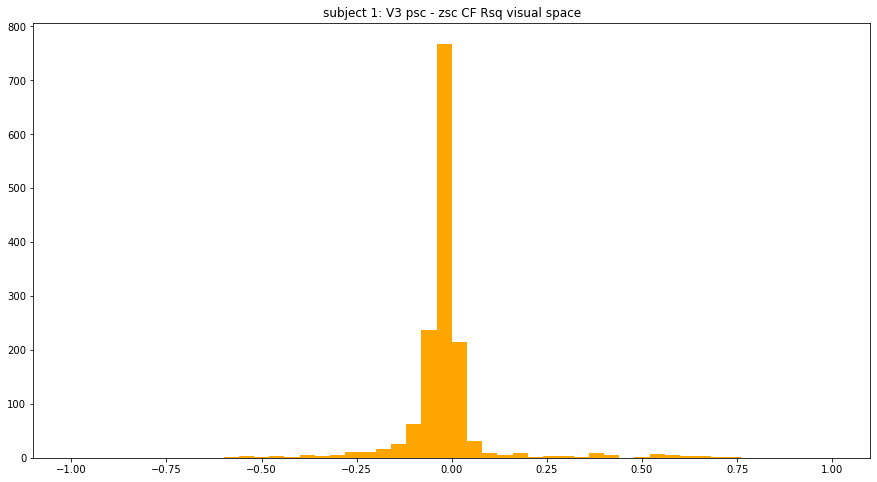

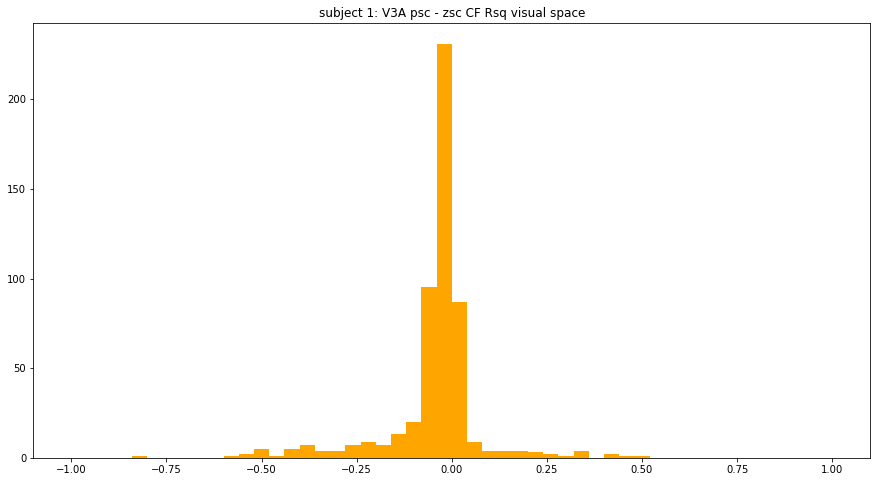

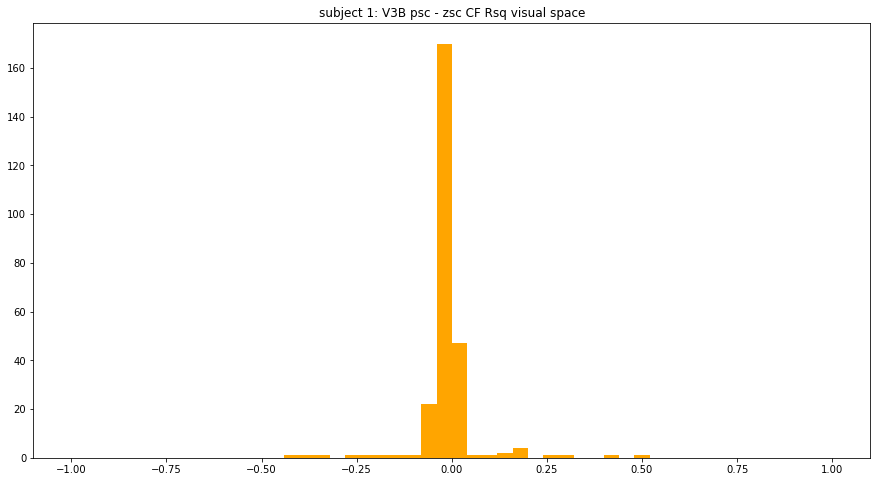

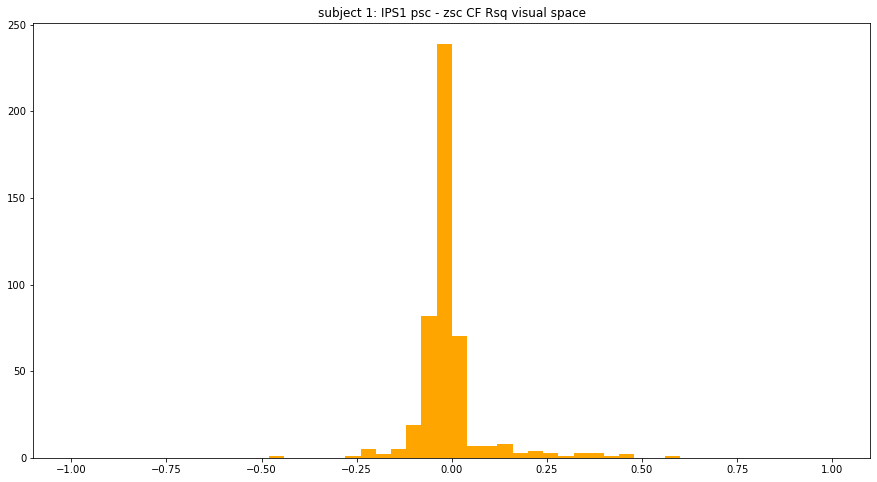

...

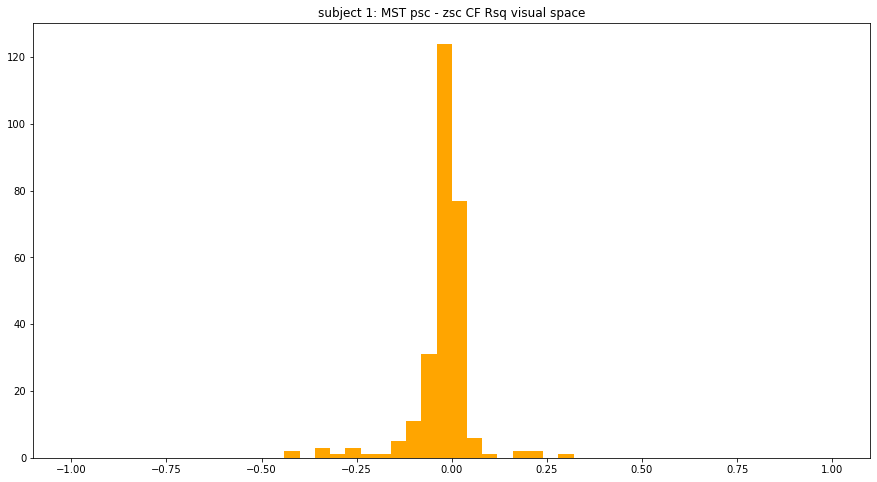

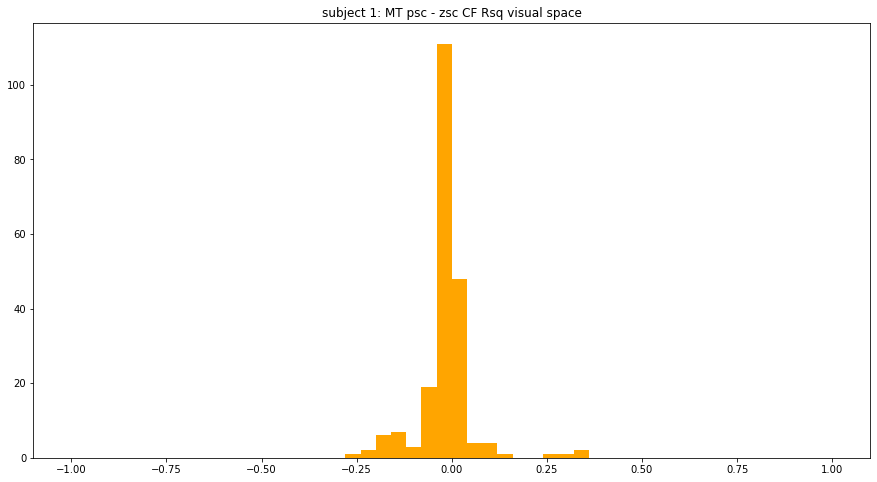

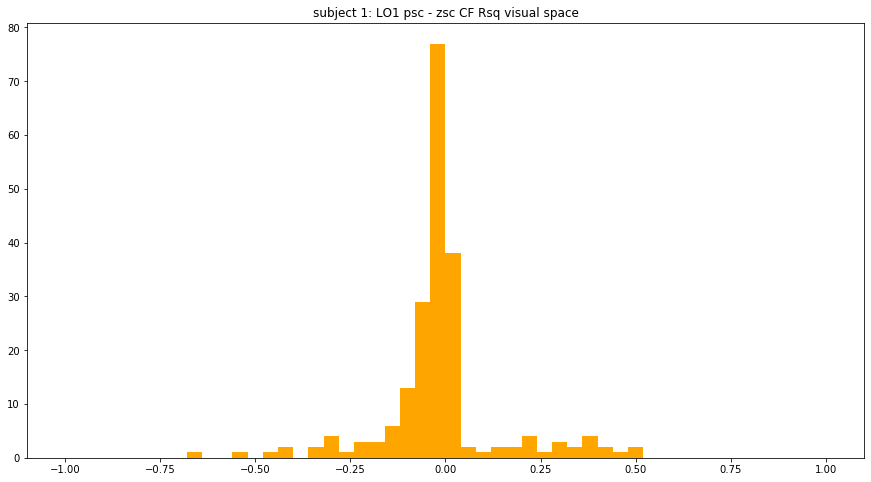

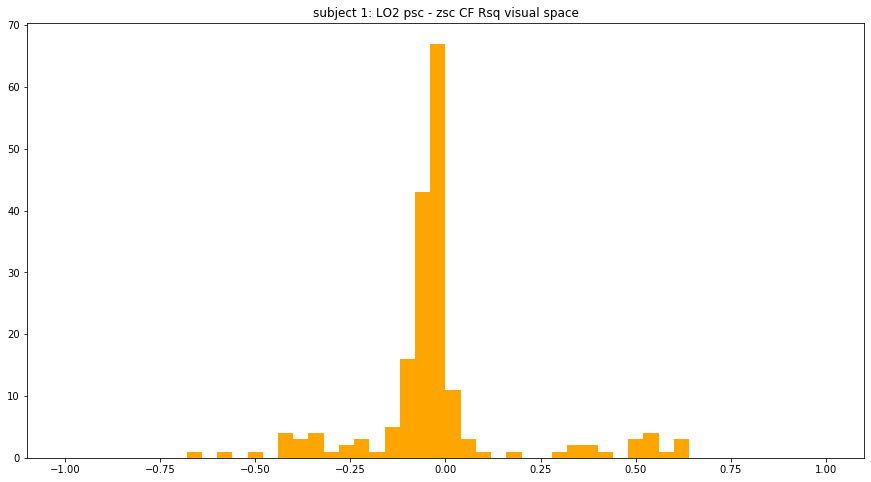

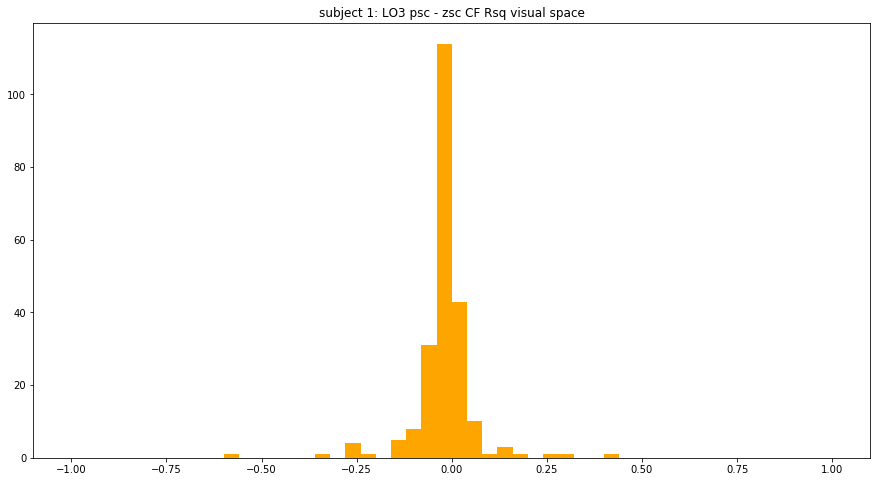

In [84]:
for keys in list(roi_index_dict.keys())[12:]:
    plt.figure(figsize=[15,8])
    roi_mask = atlas_data_both_hemis == roi_index_dict[keys]
    plt.hist(CF_vis[:,-1][roi_mask]-CF_vis_zsc[:,-1][roi_mask], bins=50, range=[-1,1], color='orange')
#     plt.hist(CF_vis_zsc[:,-1][roi_mask], alpha=0.5, label='zsc, median = ' +str(np.nanmedian(CF_vis_zsc[:,-1][roi_mask])), bins=50, range=[-1,1])
    
#     plt.legend(loc='upper left')
    plt.title('subject 1: ' + str(keys) + ' psc - zsc CF Rsq visual space')
    


### prf fits and R2 difference between norm and gauss and CF and pRF

Text(0.5, 0.98, 'CV R2 gauss CF (cortical) - norm pRF sub 1')

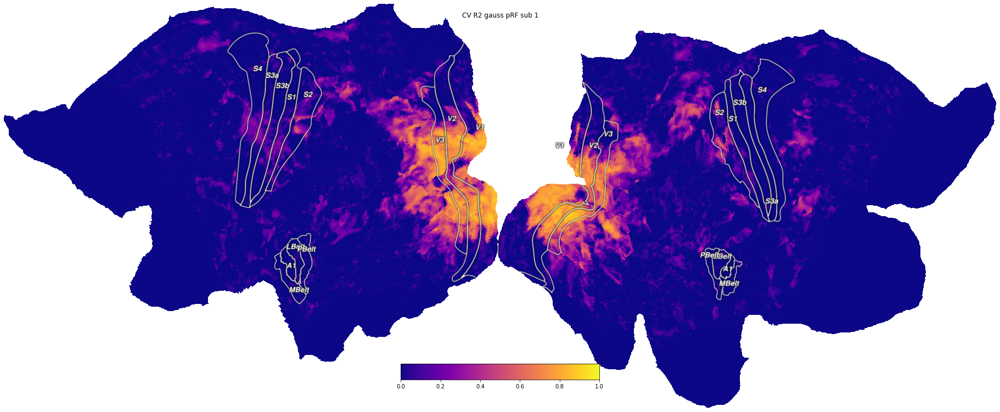

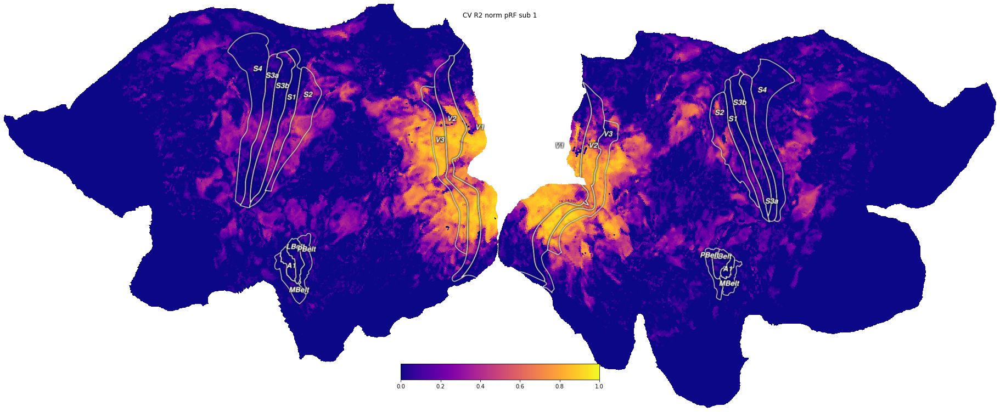

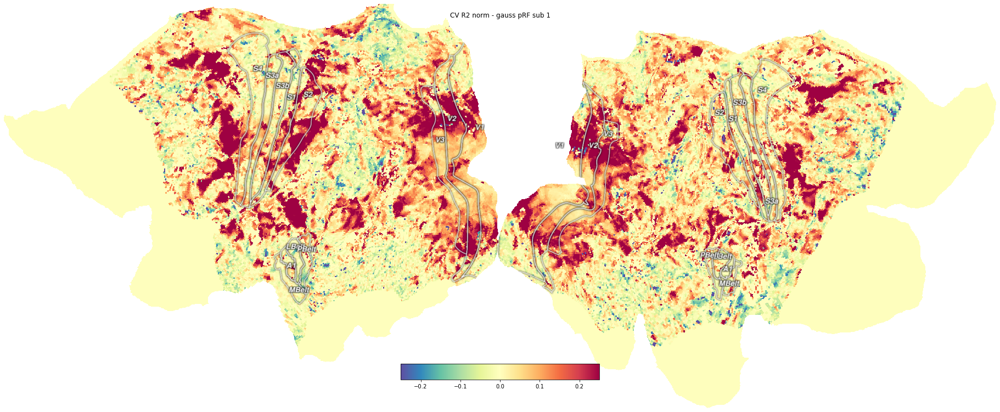

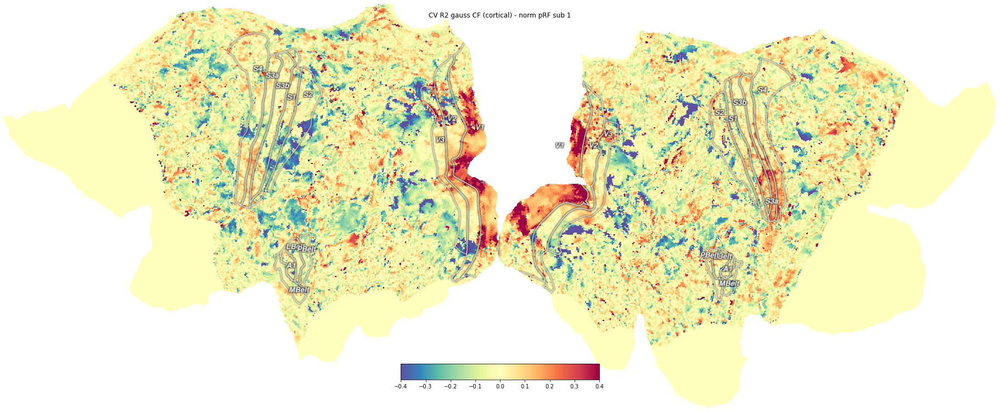

In [63]:
## prf fits and R2 difference between norm and gauss and CF and pRF

f = cortex.quickshow(cortex.Vertex(gauss_prf[:,-1], subject='hcp_999999', cmap='plasma', vmin=0,vmax=1), with_curvature=True);
f.suptitle(f'CV R2 gauss pRF sub {sub}')

f = cortex.quickshow(cortex.Vertex(norm_prf[:,-1], subject='hcp_999999', cmap='plasma', vmin=0,vmax=1), with_curvature=True);
f.suptitle(f'CV R2 norm pRF sub {sub}')

f = cortex.quickshow(cortex.Vertex(norm_prf[:,-1]-gauss_prf[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.25, vmax=0.25), with_curvature=True);
f.suptitle(f'CV R2 norm - gauss pRF sub {sub}')

f = cortex.quickshow(cortex.Vertex(CF_cort[:,-1]-norm_prf[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.4, vmax=0.4), with_curvature=True);
f.suptitle(f'CV R2 gauss CF (cortical) - norm pRF sub {sub}')

# DN CF SUB 2

In [ ]:
fold = 1
sub = 1

gauss_prf = get_cortex(np.load(f'/scratch/2021/nprf_ss/derivatives/prf-fits/sub-0{sub}/gaussian-prf/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gaussPRF_params_cv_fold{fold}.npy'))
norm_prf = get_cortex(np.load(f'/scratch/2021/nprf_ss/derivatives/prf-fits/sub-0{sub}/dn-prf/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_normPRF_params_cv_fold{fold}.npy'))

CF_cort[boolmask] = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/cortical_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_cortical_space_fold{fold}.npy')
CF_vis[boolmask] = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/visual_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_visual_space_fold{fold}.npy')

In [ ]:
s2_f = 
s2_f2 = 


In [29]:
fold = 1
sub = 2
s2_f = np.load(f"/scratch/2021/nprf_ss/derivatives/Scalars/sub-0{sub}/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_mean_timecourse_train_full_zsc.npy")
s2_f2 = np.load(f"/scratch/2021/nprf_ss/derivatives/Scalars/sub-0{sub}/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_mean_timecourse_test_full_zsc.npy")  

if fold == 1:
    mydat_train = np.nan_to_num(get_cortex(s2_f)[:,10:])
    mydat_test = np.nan_to_num(get_cortex(s2_f2)[:,10:])
    print("fold 1")


roi_verts = cortex.get_roi_verts('hcp_999999', 'V1',mask=True)

maskL=roi_verts['V1'][:59292]
maskR=roi_verts['V1'][59292:]

myv1surf=Subsurface('hcp_999999',[maskL,maskR]) # surf = fiducial, inflated, veryinflated, 
# hyperinflated, superinflated, flat, sphere

myv1surf.create()

prf_params = get_cortex(np.load(f'/scratch/2021/nprf_ss/derivatives/prf-fits/sub-0{sub}/dn-prf/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_normPRF_params_cv_fold{fold}.npy'))
gfn_ecc = ecc(prf_params[:,0], prf_params[:,1])

# create eccentricity mask and combine with Rsq and V1 mask

eccMask = gfn_ecc < 8.91243496952274
maskLecc, maskRecc = splitList(eccMask)

Rsqmask = prf_params[:,-1] > 0.4
rsqL, rsqR = splitList(Rsqmask)

V1mask = np.concatenate([maskL, maskR])

maskLecc = maskLecc*rsqL
maskRecc = maskRecc*rsqR
intmask = np.concatenate([maskLecc, maskRecc])
intmask = intmask * V1mask

distmaskL = maskLecc[maskL]
distmaskR = maskRecc[maskR]

# modify the subsurface distances to only include the vertices we want sample from
# and modify the subsurface_verts to correspond to these vertices we want to sample

myv1surf.dists_R = myv1surf.dists_R[distmaskR][:,distmaskR]
myv1surf.dists_L = myv1surf.dists_L[distmaskL][:,distmaskL]
myv1surf.pad_distance_matrices()
myv1surf.subsurface_verts=np.concatenate([myv1surf.subsurface_verts_L[distmaskL],myv1surf.subsurface_verts_R[distmaskR]])

#     f = cortex.quickshow(cortex.Vertex(intmask.astype(int), subject='hcp_999999', cmap='plasma'), with_curvature=True);
#     f.suptitle('V1 vertices that we sample')

# these should be size (N,) and (N, N)
print(myv1surf.subsurface_verts.shape)
print(myv1surf.distance_matrix.shape)

# Make stimuli for training and test data
train_stim=CFStimulus(mydat_train,myv1surf.subsurface_verts,myv1surf.distance_matrix)
test_stim=CFStimulus(mydat_test,myv1surf.subsurface_verts,myv1surf.distance_matrix)

# Make a model
model=CFGaussianModel(train_stim)
gfdn = Norm_CFGaussianModel(train_stim)

fold 1
Generating subsurfaces
Creating distance by distance matrices


/tank/klundert/anaconda3/lib/python3.7/site-packages/scipy/sparse/linalg/dsolve/linsolve.py:318: SparseEfficiencyWarning: splu requires CSC matrix format
  warn('splu requires CSC matrix format', SparseEfficiencyWarning)


(933,)
(933, 933)


In [54]:
# model.return_prediction()
# CF_norm1[boolmask]
gfdn = Norm_CFGaussianModel(train_stim)

In [45]:
CF_gauss1[boolmask].shape

(10881, 5)

In [62]:
difference = CF_norm1[boolmask][:,-1] - CF_gauss1[boolmask][:,-1]
gaussr2 = CF_gauss1[boolmask][:,-1]

In [75]:
testmask = (gaussr2 > 0.5) * (difference > 0.2)
testmask.sum()

/tank/klundert/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in greater
  """Entry point for launching an IPython kernel.


23

ValueError: cannot convert float NaN to integer

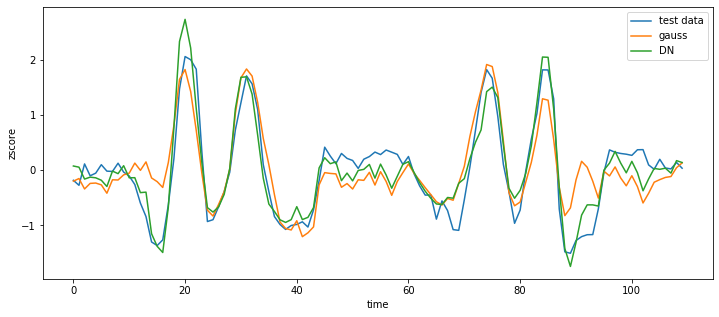

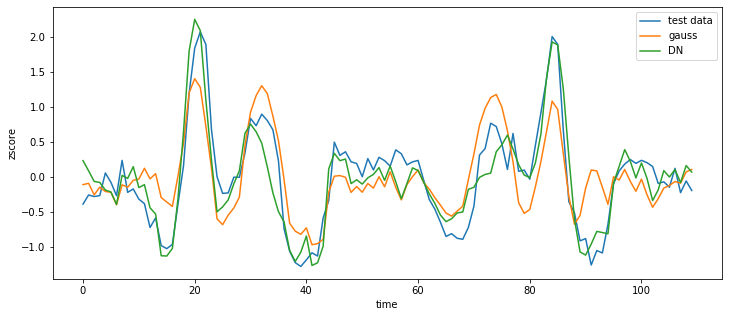

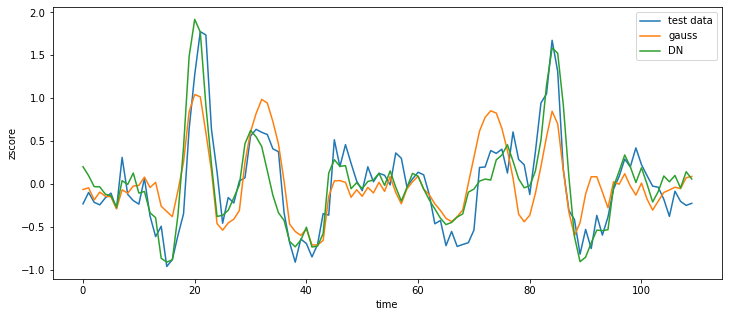

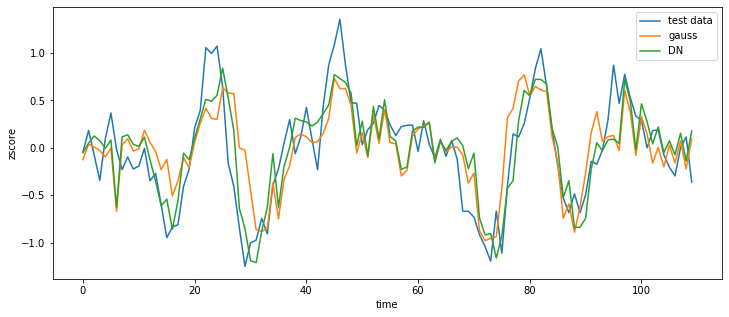

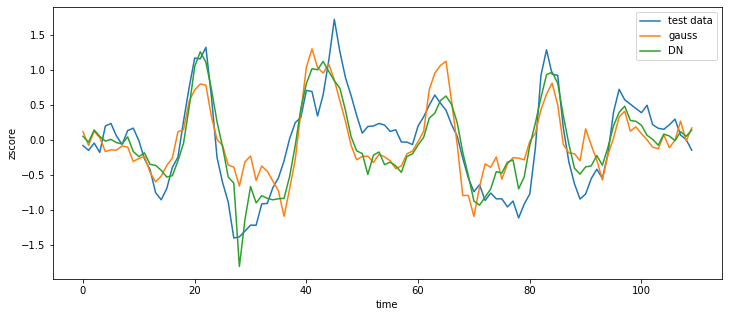

...

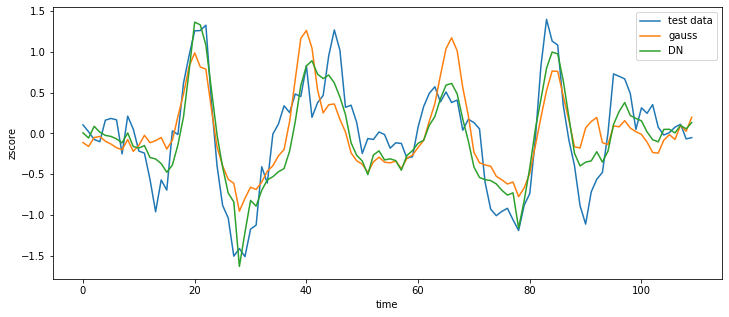

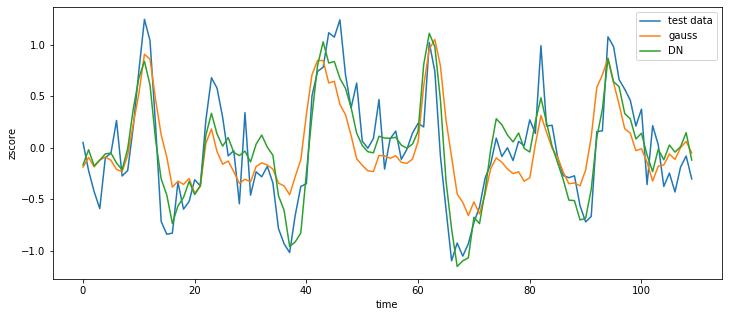

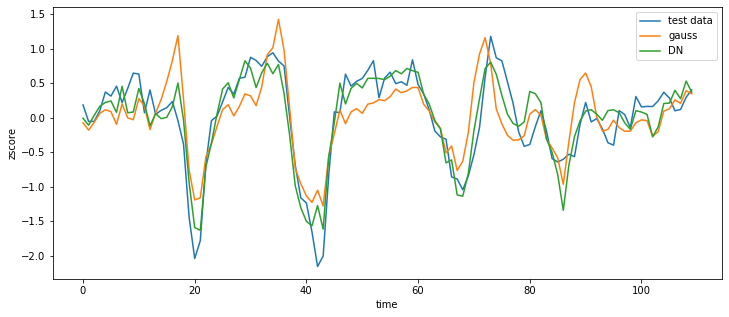

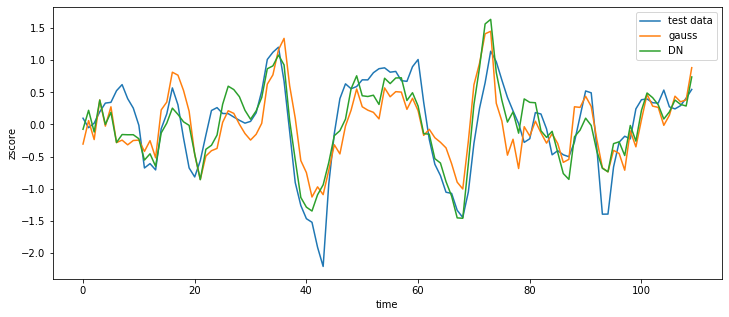

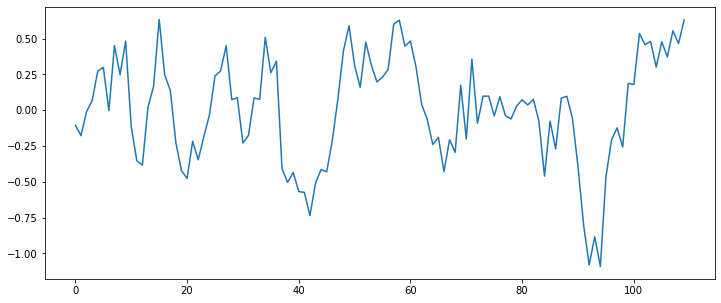

In [196]:
for i in range(23):
    plt.figure(figsize=[12,5])
    plt.plot(mydat_test[boolmask][testmask][i], label='test data')
    plt.plot(model.return_prediction(*CF_gauss1[boolmask][testmask][i,:-1]).T, label='gauss')
    plt.plot(gfdn.return_prediction(*CF_norm1[boolmask][testmask][i,:-1]).T, label='DN')
    plt.xlabel('time')
    plt.ylabel('zscore')
    plt.legend()